In [ ]:
# Montando o google drive no projeto
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Instalação de pacotes
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
! pip install --upgrade openpyxl

     | 25.9 MB 747 kB/s
     |████████████████████████████████| 10.9 MB 5.5 MB/s 
     |████████████████████████████████| 596 kB 21.9 MB/s 
     |████████████████████████████████| 102 kB 9.0 MB/s 
     |████████████████████████████████| 690 kB 42.0 MB/s 
     |████████████████████████████████| 4.7 MB 33.9 MB/s 
     |████████████████████████████████| 63 kB 1.2 MB/s 
     |████████████████████████████████| 812 kB 47.7 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.1.1-py2.py3-none-any.whl size=261287 sha256=8c265ef095296ae1b7684e24b701468718a27e2548ba996825b2b89b6f5238c6
  Stored in directory: /tmp/pip-ephem-wheel-cache-i34wxlyx/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=b5d99db6f86b8de7b7c6d0733ea85bf5181347bbb56c72b579647f31bed05cac
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d

# Objetivo do trabalho
O objetivo deste trabalho é classificar o resultado dos jogos do Brasileirão em 3 categorias: vitória, derrota ou empate. Para isso, irei utilizar (1) os dados do campeonato Brasileiro de 2014 a 2021 e (2) os dados dos jogadores dos clubes participantes das edições citadas adquiridos do CartolaFC.

<br />

Os dados do CartolaFC estão no grão jogador-rodada. Os dados do Brasileirão estão no grão clube-rodada. Irei gerar um dataset juntando os 2 conjuntos de dados chamado de ***df_full***. 

Para realizar esta operação, irei gerar o dataframe ***df_cartola*** agrupando os dados no  grão clube-rodada, no qual cada clube em cada rodada terá 4 indicadores:
1. Indicadores de ataque, meio-campo e defesa. Esses 3 indicadores serão criados realizando a média da pontuação dos jogadores de ataque, meio-campo e defesa (zagueiros, laterais e goleiros serão considerados no indicador defesa).
2. Indicador de valor, que será a média do preço dos jogadores.

A base coletada do CartolaFC traz uma série de indicadores de cada jogador, como gols marcados, cartões vermelhos e amarelos, impedimentos, chutes na trave, defesas difíceis, entre outros. Além disso, existe a pontuação calculada levando em consideração cada um desses indicadores e pesos atribuídos a cada um deles. Dessa forma, um valor final representando a força e qualidade de um jogador por rodada já existe. Esse será o valor utilizado para criar os indicadores de ataque, meio-campo e defesa neste trabalho para cada time a cada rodada, sendo todo o resto desconsiderado.

De posse de todas as informações agrupadas por clube-rodada serão aplicados 3 modelos de machine learning com o objetivo de (1) classificar o resultado dos jogos em 3 grupos, vitória, empate e derrota e (2) comparar a qualidade da previsão dos modelos.

# Importação de bibliotecas

In [ ]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, classification_report

import glob
import json
import os

# Inicializações
Inicialização de variáveis, bibliotecas e etc.

In [ ]:
%matplotlib inline
pd.set_option('display.max_columns', 100)

# Definição de funções

Definição das funções que serão utilizadas ao longo deste notebook. 

In [ ]:
def convert_json_to_csv(json_path, csv_path, encoding):
  with open(csv_path, mode='w', encoding=encoding) as fw:
    with open(json_path, encoding=encoding) as fh:
      data = json.load(fh)

      fw.write(get_header())
      
      for i in data['atletas']:
        line = get_attr(i)
        fw.write(line)

def get_attr(player):
  return f'{player["atleta_id"]};{player["rodada_id"]};{player["clube_id"]};{player["posicao_id"]}'\
  f';{player["pontos_num"]};{player["preco_num"]};{player["variacao_num"]}\n'

def get_header():
  return 'atleta_id;rodada_id;clube_id;posicao_id;pontos_num;preco_num;variacao_num\n'

def get_csv_filename(json_filename):
  return os.path.join(os.path.dirname(os.path.dirname(json_filename)), 'csv_data',
                      os.path.splitext(os.path.basename(json_filename))[0] + '.csv')

def csv_to_dataframe(pattern, encoding, separator):
    files = glob.glob(pattern)

    df = pd.DataFrame()
    for f in files:
        df = df.append(pd.read_csv(f, encoding=encoding, sep=separator))

    return df.reset_index(drop=True)

def get_year(agg_dict, year):
    if (year not in agg_dict):
        agg_dict[year] = {}

    return agg_dict[year]

def get_round(year, round):
    if (round not in year):
        year[round] = {}

    return year[round]

def get_club_with_round(agg_dict, year, round, club):
    year_rsl = get_year(agg_dict, year)
    round_rsl = get_round(year_rsl, round)

    if (club not in round_rsl):
        round_rsl[club] = {'ataque': {'value': 0, 'count': 0}, 'meio_campo': {'value': 0, 'count': 0},
                           'defesa': {'value': 0, 'count': 0}, 'valor': {'value': 0, 'count': 0}}

    return round_rsl[club]

def get_club(agg_dict, year, club):
    year_rsl = get_year(agg_dict, year)

    if (club not in year_rsl):
        year_rsl[club] = {'vitoria': 0, 'derrota': 0, 'empate': 0, 'total_gols': 0,
                          'mandante_gols_feitos_casa': 0, 'mandante_gols_sofridos_casa': 0,
                          'visitante_gols_feitos_fora_casa': 0,
                          'visitante_gols_sofridos_fora_casa': 0}

    return year_rsl[club]

# objeto gerado pela função abaixo
# {"2014": {"1": {"VAS": {
#                         "ataque": {"value": 10,"count": 3},
#                         "meio_campo": {"value": 10,"count": 3},
#                         "defesa": {"value": 10,"count": 3},
#                         "valor": {"value": 10,"count": 3}},
#                 "PAL": {"ataque": {"value": 10,"count": 3},
#                         "meio_campo": {"value": 10,"count": 3},
#                         "defesa": {"value": 10, "count": 3},
#                         "valor": {"value": 10,"count": 3}}}}}
def compute_indicators_cartola(agg_dict, row):
    club = get_club_with_round(agg_dict, row['ano'], row['rodada'], row['clube'])

    if (row['posicao'] == 'ata'):
        club['ataque']['value'] += row['pontos']
        club['ataque']['count'] += 1
    elif (row['posicao'] == 'mei'):
        club['meio_campo']['value'] += row['pontos']
        club['meio_campo']['count'] += 1
    elif ((row['posicao'] == 'gol') or (row['posicao'] == 'lat') or (row['posicao'] == 'zag')):
        club['defesa']['value'] += row['pontos']
        club['defesa']['count'] += 1

    club['valor']['value'] += row['preco']
    club['valor']['count'] += 1

def compute_indicators_brasileirao(agg_dict, agg_list, row):
    club_home = get_club(agg_dict, row['ano'], row['mandante'])
    club_away = get_club(agg_dict, row['ano'], row['visitante'])

    agg_list.append([row['ano'], row['rodada'], row['mandante'], row['visitante'], club_home['vitoria'],
                     club_home['derrota'], club_home['empate'], club_away['vitoria'], club_away['derrota'],
                     club_away['empate'], club_home['total_gols'], club_away['total_gols'],
                     club_home['mandante_gols_feitos_casa'], club_home['mandante_gols_sofridos_casa'],
                     club_away['visitante_gols_feitos_fora_casa'], club_away['visitante_gols_sofridos_fora_casa']])

    if row['vencedor'] == 1:
        club_home['vitoria'] += 1
        club_away['derrota'] += 1
    elif row['vencedor'] == 0:
        club_home['derrota'] += 1
        club_away['vitoria'] += 1
    else:
        club_home['empate'] += 1
        club_away['empate'] += 1

    club_home['total_gols'] += row['placar_mandante']
    club_away['total_gols'] += row['placar_visitante']

    club_home['mandante_gols_feitos_casa'] += row['placar_mandante']
    club_home['mandante_gols_sofridos_casa'] += row['placar_visitante']
    club_away['visitante_gols_feitos_fora_casa'] += row['placar_visitante']
    club_away['visitante_gols_sofridos_fora_casa'] += row['placar_mandante']

def dict_to_list(agg_dict):
    rsl = []
    for year, value_round in agg_dict.items():

        for round, value_club in value_round.items():

            for club, indicators in value_club.items():

                inds = []
                for indicator, values in indicators.items():
                    inds.append(values['value'])
                    inds.append(values['count'])

                row = [year, round, club] + inds
                rsl.append(row)

    return rsl

def list_to_dataframe(list_transform, columns):
    return pd.DataFrame(list_transform, columns=columns)

def fill_indicators(df):
  primeira_rodada_df = 0
  rodada = 0
  clubes_indicadores = []
  idx_df = 0
  indice = 0
  ataque = 0
  ataque_soma = 0
  meio_campo = 0
  meio_campo_soma = 0
  defesa = 0
  defesa_soma = 0
  valor = 0
  valor_soma = 0

  for i in range(0, 38 * 20 * 6):
    rodada = (i % 38) + 1
    roddf = df.loc[idx_df, 'rodada']

    if rodada == 1:
      ataque_soma = 0
      meio_campo_soma = 0
      defesa_soma = 0
      valor_soma = 0
      primeira_rodada_df = df.loc[idx_df, 'rodada']

    if rodada == roddf:
      ataque_soma += df.loc[idx_df, 'ataque']
      meio_campo_soma += df.loc[idx_df, 'meio_campo']
      defesa_soma += df.loc[idx_df, 'defesa']
      valor_soma += df.loc[idx_df, 'valor']

      if idx_df < df.shape[0]:
          idx_df += 1
      else:
          idx_df = df.shape[0]
    else:
      if rodada == 1 or (rodada < primeira_rodada_df):
        indice = idx_df
        ataque = df.loc[idx_df, 'ataque']
        meio_campo = df.loc[idx_df, 'meio_campo']
        defesa = df.loc[idx_df, 'defesa']
        valor = df.loc[idx_df, 'valor']
      else:
        indice = idx_df - 1
        ataque = ataque_soma/(rodada - 1)
        meio_campo = meio_campo_soma / (rodada - 1)
        defesa = defesa_soma / (rodada - 1)
        valor = valor_soma / (rodada - 1)

      clubes_indicadores.append([df.loc[indice, 'ano'], rodada, df.loc[indice, 'clube'], ataque, meio_campo, defesa, valor])
      ataque_soma += ataque
      meio_campo_soma += meio_campo
      defesa_soma += defesa
      valor_soma += valor
  
  rsl = list_to_dataframe(clubes_indicadores, ['ano', 'rodada', 'clube', 'ataque',
                                               'meio_campo', 'defesa', 'valor'])
  return df.append(rsl)

def translate_vencedor(row):
  if (row['vencedor'] == row['mandante']):
      return 1
  elif (row['vencedor'] == row['visitante']):
      return 0
  else:
      return 2

def find_sequence(column):
  sequence = [0]

  [sequence.append(sequence[-1]+1) if value==1 else sequence.append(0) for value in column.values]

  return sequence[0:-1]


# Coleta dos dados

## CartolaFC
Três conjuntos de dados da base do CartolaFC foram utilizados neste trabalho:

*   Arquivos com indicadores dos jogadores obtidos do CartolaFC de 2014 a 2021 baixados do [GitHub](https://github.com/henriquepgomide/caRtola/tree/master/data) no dia 12/01/2022 às 22:54.

*   Arquivos contendo todos os clubes do CartolaFC baixado do [GitHub](https://github.com/henriquepgomide/caRtola/blob/master/data/times_ids.csv) no dia 17/11/2021 às 23:30. Esse arquivo foi tratado manualmente com as seguintes operações:

   *   Colunas retiradas: escudos.30x30, escudos.45x45, escudos.60x60, nome.cbf, nome.completo, cod.older, cod.2017, cod.2018, abreviacao.
   *   Criado identificador semântico para os clubes chamado abreviacao.
   *   Coluna **nome.cartola** renomeada para **nome_clube**.
   *   Valores da colune nome_clube foram colocados todos em maiúsculos.
   *   Acrescentado o clube 280 indicando o Bragantino.
   *   Acrescentado o clube 1371 indicando o Cuiabá.
   *   Id do Joinville alterado de 215 para 317.
   *   Id do Criciúma alterado de 206 para 288.
   *   Gerado o arquivo clubes_id.xlsx.

*   Arquivo de posições de jogo e os ids indicativos, por exemplo, 1 - zagueiro, 2 - atacante, etc. Este arquivo foi baixado do [GitHub](https://github.com/henriquepgomide/caRtola/blob/master/data/posicoes_ids.csv) no dia 12/01/2022 às 22:54.

Os indicadores do CartolaFC para as edições do Brasileirão de 2014 a 2017 estão em um único arquivo. Será gerado um único dataframe (***df_2014_2017***) que conterá todos os indicadores de 2014 a 2017.

Os indicadores do CartolaFC para as edições do Brasileirão de 2018 a 2021 estão em arquivos separados por rodada. Todos os arquivos de uma mesma edição do Brasileirão de 2018 a 2021 estão reunidos na pasta do respectivo ano. Neste caso, será criado um dataframe para cada ano, ***df_2018***, ***df_2019***, ***df_2020*** e ***df_2021***.

O arquivo de clubes ficará no dataframe ***df_clubes_ids***. O arquivo de posições de jogo ficará no dataframe ***df_posicoes***.

### Leitura das bases de apoio
As bases de posições de jogos e dos clubes serão carregados nos respectivos dataframes ***df_posicoes*** e ***df_clubes_ids***.

In [ ]:
df_posicoes = pd.read_csv('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                          'dados-cartola/posicoes_ids.csv')

df_clubes_ids = pd.read_excel('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                              'dados-cartola/clubes_ids.xlsx')

### Anos de 2014 a 2017
Os indicadores dos jogadores das edições de 2014 a 2017 estão armazenados em um único arquivo csv.

O arquivo csv foi armazenado em um único dataframe chamado ***df_2014_2017***, durante a leitura as seguintes operações foram realizadas:

*   As colunas **Jogos**, **Participou**, **FS**, **PE**, **A**, **FT**, **FD**, **FF**, **G**, **I**, **PP**, **RB**, **FC**, **GC**, **CA**, **CV**, **SG**, **DD**, **DP**, **GS**, **Status**, **avg.Points**, **avg.last05**, **avg.FS**, **avg.FS.l05**, **avg.PE**, **avg.PE.l05**, **avg.A**, **avg.A.l05**, **avg.FT**, **avg.FT.l05**, **avg.FD**, **avg.FD.l05**, **avg.FF**, **avg.FF.l05**, **avg.G**, **avg.G.l05**, **avg.I**, **avg.I.l05**, **avg.PP**, **avg.PP.l05**, **avg.RB**, **avg.RB.l05**, **avg.FC**, **avg.FC.l05**, **avg.GC**, **avg.GC.l05**, **avg.CA**, **avg.CV.l05**, **avg.SG**, **avg.SG.l05**, **avg.DD**, **avg.DD.l05**, **avg.DP**, **avg.DP.l05**, **avg.GS**, **avg.GS.l05**, **risk_points**, **mes**, **dia**, **home.score.x**, **away.score.x**, **pred.home.score**, **pred.away.score**, **home.attack**, **home.defend**, **variable** e **PontosMedia foram ignoradas por não possuírem utilidade.
*   A coluna **Apelido** representa o apelido do jogador e está incompleta. Ela será criada futuramente para poder identificar o jogador a partir do seu nome e, por isso, será deletada.


In [ ]:
# Leitura do arquivo csv
df_2014_2017 = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                                'dados-cartola/2014_2017/2017_dados*.csv', 'utf-8', ',')

In [ ]:
# Listando colunas
df_2014_2017.columns

Index(['AtletaID', 'Rodada', 'ClubeID', 'Participou', 'Posicao', 'Jogos',
       'Pontos', 'PontosMedia', 'Preco', 'PrecoVariacao', 'FS', 'PE', 'A',
       'FT', 'FD', 'FF', 'G', 'I', 'PP', 'RB', 'FC', 'GC', 'CA', 'CV', 'SG',
       'DD', 'DP', 'GS', 'ano', 'Apelido', 'Status', 'avg.Points',
       'avg.last05', 'avg.FS', 'avg.FS.l05', 'avg.PE', 'avg.PE.l05', 'avg.A',
       'avg.A.l05', 'avg.FT', 'avg.FT.l05', 'avg.FD', 'avg.FD.l05', 'avg.FF',
       'avg.FF.l05', 'avg.G', 'avg.G.l05', 'avg.I', 'avg.I.l05', 'avg.PP',
       'avg.PP.l05', 'avg.RB', 'avg.RB.l05', 'avg.FC', 'avg.FC.l05', 'avg.GC',
       'avg.GC.l05', 'avg.CA', 'avg.CV.l05', 'avg.SG', 'avg.SG.l05', 'avg.DD',
       'avg.DD.l05', 'avg.DP', 'avg.DP.l05', 'avg.GS', 'avg.GS.l05',
       'risk_points', 'mes', 'dia', 'home.score.x', 'away.score.x',
       'pred.home.score', 'pred.away.score', 'home.attack', 'home.defend',
       'variable'],
      dtype='object')

In [ ]:
# Remoção das colunas sem utilidade
df_2014_2017.drop(columns=['Jogos', 'Participou', 'FS', 'PE', 'A', 'FT', 'FD', 
                           'FF', 'G', 'I', 'PP', 'RB', 'FC', 'GC', 'CA', 'CV', 
                           'SG', 'DD', 'DP', 'GS', 'Status', 'avg.Points', 
                           'avg.last05', 'avg.FS', 'avg.FS.l05', 'avg.PE', 
                           'avg.PE.l05', 'avg.A', 'avg.A.l05', 'avg.FT',
                           'avg.FT.l05', 'avg.FD', 'avg.FD.l05', 'avg.FF',
                           'avg.FF.l05', 'avg.G', 'avg.G.l05', 'avg.I', 
                           'avg.I.l05', 'avg.PP', 'avg.PP.l05', 'avg.RB',
                           'avg.RB.l05', 'avg.FC', 'avg.FC.l05', 'avg.GC', 
                           'avg.GC.l05', 'avg.CA', 'avg.CV.l05', 'avg.SG', 
                           'avg.SG.l05', 'avg.DD', 'avg.DD.l05', 'avg.DP', 
                           'avg.DP.l05', 'avg.GS', 'avg.GS.l05', 'risk_points',
                           'mes', 'dia', 'home.score.x', 'away.score.x', 
                           'pred.home.score', 'pred.away.score', 'home.attack',
                           'home.defend', 'variable', 'Apelido', 'PontosMedia'],
                   inplace=True)

df_2014_2017.head(5)

,AtletaID,Rodada,ClubeID,Posicao,Pontos,Preco,PrecoVariacao,ano
0,36443,1,285.0,gol,5.0,10.60,1.60,2014
1,36443,2,285.0,gol,-3.0,8.27,-2.33,2014
2,36443,3,285.0,gol,-2.6,6.81,-1.46,2014
3,36443,4,285.0,gol,4.0,7.96,1.15,2014
4,36443,5,285.0,gol,5.0,8.61,0.65,2014


### Ano de 2018
Os indicadores dos jogadores da edição de 2018 estão armazenados em arquivos csv. Existem no total 38 arquivos representando as 38 rodadas.


Os arquivos csv foram lidos e agrupados em um único dataframe chamado ***df_2018***, durante a leitura as seguintes operações foram realizadas:

*   As colunas **Unnamed: 0**, **atletas.nome**, **atletas.slug**, **atletas.apelido**, **atletas.status_id**, **atletas.foto**, **FC**, **FD**, **FF**, **FS**, **G**, **I**, **RB**, **CA**, **PE**, **A**, **SG**, **DD**, **FT**, **GS**, **CV**, **GC**, **PP**, **DP** e **atletas.media_num** foram ignoradas por não possuírem utilidade.


In [ ]:
# Leitura dos arquivos csv
df_2018 = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                           'dados-cartola/2018/rodada-*.csv', 'utf-8', ',')

In [ ]:
# Listando as colunas de df_2018
df_2018.columns

Index(['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido',
       'atletas.foto', 'atletas.atleta_id', 'atletas.rodada_id',
       'atletas.clube_id', 'atletas.posicao_id', 'atletas.status_id',
       'atletas.pontos_num', 'atletas.preco_num', 'atletas.variacao_num',
       'atletas.media_num', 'atletas.clube.id.full.name', 'FC', 'FS', 'PE',
       'FD', 'FF', 'I', 'RB', 'CA', 'SG', 'A', 'G', 'DD', 'GS', 'FT', 'GC',
       'DP', 'CV', 'PP'],
      dtype='object')

In [ ]:
# Remoção das colunas sem utilidade
df_2018.drop(columns=['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido', 
                      'atletas.status_id', 'atletas.foto', 'FC', 'FD', 'FF', 'FS', 
                      'G', 'I', 'RB', 'CA', 'PE', 'A', 'SG', 'DD', 'FT', 'GS', 'CV',
                      'GC', 'PP', 'DP', 'atletas.media_num'],
              inplace=True)

df_2018.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num,atletas.clube.id.full.name
0,99878,12,PAL,ata,0.0,2.00,0.00,Palmeiras
1,99588,12,VAS,ata,0.0,2.68,0.00,Vasco
2,99789,12,SAO,ata,3.9,2.81,0.05,São Paulo
3,99595,12,CEA,zag,0.0,1.80,0.00,Ceará
4,99881,12,VAS,zag,0.0,3.07,0.00,Vasco


### Ano de 2019
Os indicadores dos jogadores da edição de 2019 estão armazenados em arquivos csv. Existem no total 38 arquivos representando as 38 rodadas.


Os arquivos csv foram lidos e agrupados em um único dataframe chamado ***df_2019***, durante a leitura as seguintes operações foram realizadas:

*   As colunas **Unnamed: 0**, **atletas.nome**, **atletas.slug**, **atletas.apelido**, **atletas.status_id**, **atletas.foto**, **atletas.clube.id.full.name**, **FS**, **RB**, **PE**, **FC**, **G**, **FF**, **FT**, **FD**, **DD**, **GS**, **SG**, **A**, **CA**, **I**, **CV**, **PP**, **GC**, **DP** e **atletas.media_num** foram ignoradas por não possuírem utilidade.


In [ ]:
# Leitura dos arquivos csv
df_2019 = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                           'dados-cartola/2019/rodada-*.csv', 'utf-8', ',')

In [ ]:
# Listando as colunas de df_2019
df_2019.columns

Index(['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido',
       'atletas.foto', 'atletas.atleta_id', 'atletas.rodada_id',
       'atletas.clube_id', 'atletas.posicao_id', 'atletas.status_id',
       'atletas.pontos_num', 'atletas.preco_num', 'atletas.variacao_num',
       'atletas.media_num', 'atletas.clube.id.full.name', 'FC', 'FD', 'FF',
       'FS', 'I', 'PE', 'RB', 'A', 'CA', 'G', 'SG', 'CV', 'DD', 'DP', 'GS',
       'PP', 'GC', 'FT'],
      dtype='object')

In [ ]:
# Remoção das colunas sem utilidade
df_2019.drop(columns=['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido', 
                      'atletas.status_id', 'atletas.foto', 'atletas.clube.id.full.name',
                      'FS', 'RB', 'PE', 'FC', 'G', 'FF', 'FT', 'FD', 'DD', 'GS', 'SG',
                      'A', 'CA', 'I', 'CV', 'PP', 'GC', 'DP', 'atletas.media_num'], 
             inplace=True)

df_2019.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num
0,37655,15,290,ata,0.1,3.60,-0.32
1,37673,15,341,ata,0.9,4.36,-0.56
2,37688,15,263,mei,-3.3,12.18,-0.78
3,42477,15,315,zag,5.8,5.49,0.98
4,37662,15,293,lat,0.0,7.30,0.00


### Ano de 2020
Os indicadores dos jogadores da edição de 2020 estão armazenados em arquivos csv. Existem no total 38 arquivos representando as 38 rodadas.


Os arquivos csv foram lidos e agrupados em um único dataframe chamado ***df_2020***, durante a leitura as seguintes operações foram realizadas:

*   As colunas **Unnamed: 0**, **atletas.nome**, **atletas.slug**, **atletas.apelido**, **atletas.foto**, **atletas.status_id**, **atletas.jogos_num**, **atletas.clube.id.full.name**, **DS**, **FC**, **FS**, **G**, **PI**, **CA**, **FF**, **A**, **SG**, **GS**, **I**, **DD**, **FD**, **FT**, **CV**, **GC**, **PP**, **DP**, **athletes$atletas$scout** e **atletas.media_num** foram ignoradas por não possuírem utilidade.

In [ ]:
# Leitura dos arquivos csv
df_2020 = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                           'dados-cartola/2020/rodada-*.csv', 'utf-8', ',')

In [ ]:
# Listando colunas de df_2020
df_2020.columns

Index(['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido',
       'atletas.foto', 'atletas.atleta_id', 'atletas.rodada_id',
       'atletas.clube_id', 'atletas.posicao_id', 'atletas.status_id',
       'atletas.pontos_num', 'atletas.preco_num', 'atletas.variacao_num',
       'atletas.media_num', 'atletas.jogos_num', 'atletas.clube.id.full.name',
       'CA', 'DD', 'DP', 'DS', 'FC', 'FD', 'FF', 'FS', 'G', 'GS', 'PI', 'SG',
       'A', 'I', 'FT', 'PP', 'CV', 'GC', 'athletes$atletas$scout'],
      dtype='object')

In [ ]:
# Remoção das colunas sem utilidade
df_2020.drop(columns=['Unnamed: 0', 'atletas.nome', 'atletas.slug', 'atletas.apelido', 
                      'atletas.foto', 'atletas.status_id', 'atletas.jogos_num', 
                      'atletas.clube.id.full.name', 'DS', 'FC', 'FS', 'G', 'PI',
                      'CA', 'FF', 'A', 'SG', 'GS', 'I', 'DD', 'FD', 'FT', 'CV',
                      'GC', 'PP', 'DP', 'athletes$atletas$scout', 'atletas.media_num'],
              inplace=True)

df_2020.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num
0,90933,26,373,gol,0.0,10.41,0.00
1,91203,26,373,zag,0.0,3.08,0.00
2,38229,26,264,lat,1.5,6.46,-1.60
3,69012,26,293,gol,3.0,6.15,-0.02
4,89815,26,373,mei,0.0,7.61,0.00


### Ano de 2021
Os indicadores dos jogadores da edição de 2021 estão armazenados em arquivos JSON. Existem no total 39 arquivos, 38 representando as 38 rodadas mais 1 arquivo com os dados iniciais dos jogadores como se fosse a rodada 0 para inicialização dos indicadores.


Os arquivos JSON foram lidos, convertidos em csv e armazenados no drive, durante a leitura as seguintes operações foram realizadas:

*   As chaves **clubes**, **posicoes** e **status** foram ignoradas por não possuírem utilidade.
*   As chaves **slug**, **apelido_abreviado**, **foto** e **media_num** contidas na chave **atletas** foram ignoradas por não possuírem utilidade.
*   Geração de um arquivo csv para cada arquivo lido contendo as colunas **scout**, **atleta_id**, **rodada_id**, **clube_id**, **posicao_id**, **status_id**, **pontos_num**, **preco_num** e **variacao_num**.

Por fim, estes arquivos serão agrupados em um único dataframe chamado ***df_2021***.

In [ ]:
# Leitura dos arquivos json
for filename in glob.glob('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                          'dados-cartola/2021/raw_data/Mercado_*.json'):
  csv_path = get_csv_filename(filename)
  
  convert_json_to_csv(filename, csv_path, 'iso-8859-1')

In [ ]:
# Agrupando em um único dataframe
df_2021 = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/projeto-final/'\
                           'dados-cartola/2021/csv_data/Mercado_*.csv', 'iso-8859-1', ';')

df_2021.head(5)

,atleta_id,rodada_id,clube_id,posicao_id,pontos_num,preco_num,variacao_num
0,51772,17,262,4,1.3,7.62,-1.14
1,83433,17,285,4,3.6,9.29,0.45
2,73465,17,266,3,2.7,9.78,0.41
3,78435,17,262,5,14.6,9.93,2.43
4,87342,17,284,3,0.0,8.34,0.00


## Brasileirão
Os dados da base do Brasileirão utilizados neste trabalho contém dados como vencedor, mandante, vistante local, data e hora, rodada, placar e etc de 2003 a 2021 baixado do [Kaggle](https://www.kaggle.com/adaoduque/campeonato-brasileiro-de-futebol) no dia 01/02/2022 às 18:31. Para este arquivo, será criado o dataframe ***df_brasileirao***.

### Dados gerais do Brasileirão
Os dados estão armazenados em um único arquivo csv contendo as edições de 2003 até 2021.

O arquivo csv foi armazenado em um único dataframe chamado ***df_brasileirao***, durante a leitura as seguintes operações foram realizadas:

*   As colunas **ID**, **Hora**, **Dia**, **Arena**, **Mandante Estado**, **Visitante Estado** e **Estado Vencedor** foram ignoradas por não possuírem utilidade.

In [ ]:
# Leitura do arquivo csv
df_brasileirao = csv_to_dataframe('/content/drive/MyDrive/cursos/pos-puc-minas/' \
                                  'projeto-final/dados-brasileirao/campeonato-brasileiro-full.csv',
                                  'utf-8', ',')

In [ ]:
# Listando as colunas de df_brasileirao
df_brasileirao.columns

Index(['ID', 'Rodada', 'Data', 'Hora', 'Dia', 'Mandante', 'Visitante',
       'Vencedor', 'Arena', 'Mandante Placar', 'Visitante Placar',
       'Mandante Estado', 'Visitante Estado', 'Estado Vencedor'],
      dtype='object')

In [ ]:
# Remoção das colunas sem utilidade
df_brasileirao.drop(columns=['ID', 'Hora', 'Dia', 'Arena', 'Mandante Estado',
                             'Visitante Estado', 'Estado Vencedor'], inplace=True)

df_brasileirao.head(5)

,Rodada,Data,Mandante,Visitante,Vencedor,Mandante Placar,Visitante Placar
0,1,2003-03-29,Guarani,Vasco,Guarani,4,2
1,1,2003-03-29,Athletico-PR,Gremio,Athletico-PR,2,0
2,1,2003-03-30,Flamengo,Coritiba,-,1,1
3,1,2003-03-30,Goias,Paysandu,-,2,2
4,1,2003-03-30,Internacional,Ponte Preta,-,1,1


# Processamento/tratamento dos dados



### Cartola
Alguns tratamentos nos dados precisam ser realizados para melhorar a qualidade final da informação, como eliminar informação desnecessária, corrigir erros, fazer agrupamentos, eliminar/preencher valores nulo, enriquecer com outros dados, entre outras operações.

As operações a ser realizadas são:

> (Passo 1) df_2014_2017



1.   Enriquecer com a base ***df_clubes_ids***. Somente a coluna **abreviacao** (oriunda da base de clubes) permanecerá, porém com o nome substituído para **clube**. As colunas de join e as colunas advindas da base de clubes serão deletadas.
2.   Renomear as colunas de acordo com a tabela.

coluna antes  | coluna depois
------------- | -------------
AtletaID      | jogador_id
Rodada        | rodada
Posicao       | posicao
Pontos        | pontos
Preco         | preco
PrecoVariacao | preco_variacao

3.   Remover as linhas com a coluna **posicao** igual a *tec*, porque, como explicado na seção `Objetivo do trabalho`, a criação dos indicadores de forças de um clube e o indicador de valor, leva em consideração somente jogadores de linha, que possuem a coluna **posicao** igual a *ata*, *mei*, *zag*, *lat* e *gol*.

<br>

> (Passo 2) df_2018, df_2019 e df_2020

1.   Enriquecer com a base ***df_clubes_ids***. Somente a coluna **abreviacao** (oriunda da base de clubes) permanecerá, porém com o nome substituído para **clube**. As colunas de join e as colunas advindas da base de clubes serão deletadas.
2.   Renomear as colunas de acordo com a tabela.

coluna antes         | coluna depois
-------------------- | -------------
atletas.atleta_id    | jogador_id
atletas.rodada_id    | rodada
atletas.posicao_id   | posicao
atletas.pontos_num   | pontos
atletas.preco_num    | preco
atletas.variacao_num | preco_variacao

3.   Remover as linhas dos jogadores que não jogaram uma determinada rodada. Esta remoção será realiza excluindo as linhas cujas colunas **pontos** e **preco_variacao** possuam valor igual a 0. Não faz sentido utilizar calcular as 4 forças de um clube e o indicador de valor utilizando informação de jogadores que não participaram de uma determinada rodada.
4.   Adicionar uma coluna para identificar o ano do campeonato.
5.   Remover as linhas com a coluna **posicao** igual a *tec*, porque, como explicado na seção `Objetivo do trabalho`, a criação dos indicadores de forças de um clube e o indicador de valor, leva em consideração somente jogadores de linha, que possuem a coluna **posicao** igual a *ata*, *mei*, *zag*, *lat* e *gol*.

<br>

> (Passo 3) df_2021

1.   Enriquecer com a base ***df_clubes_ids***. Somente a coluna **abreviacao** (oriunda da base de clubes) permanecerá, porém com o nome substituído para **clube**. As colunas de join e as colunas advindas da base de clubes serão deletadas.
2.   Enriquecer com a base ***df_posicoes***. Somente a coluna **abbr** (oriunda da base de posições) permanecerá, porém com o nome substituído para **posicao**. As colunas de join e as colunas advindas da base de posições serão deletadas.
3.   Renomear as colunas de acordo com a tabela.

coluna antes  | coluna depois
------------- | -------------
atleta_id     | jogador_id
rodada_id     | rodada
pontos_num    | pontos
preco_num     | preco
variacao_num  | preco_variacao


4.   Remover as linhas dos jogadores que não jogaram uma determinada rodada. Esta remoção será realiza excluindo as linhas cujas colunas **pontos** e **preco_variacao** possuam valor igual a 0. Não faz sentido utilizar calcular as 3 forças de um clube utilizando informação de jogadores que não participaram de uma determinada rodada.
5.   Adicionar uma coluna para identificar o ano do campeonato.
6.   Remover as linhas com a coluna **posicao** igual a *tec*, porque, como explicado na seção `Objetivo do trabalho`, a criação dos indicadores de forças de um clube e o indicador de valor, leva em consideração somente jogadores de linha, que possuem a coluna **posicao** igual a *ata*, *mei*, *zag*, *lat* e *gol*.

> (Passo 4) df_cartola

1.   No final de todas os passos acima, um dataframe chamado ***df_cartola*** será criado reunindo os dataframes ***df_2014_2017***, ***df_2018***, ***df_2019***, ***df_2020*** e ***df_2021***.

#### Passo 1

In [ ]:
# Listando df_2014_2017
df_2014_2017.head(5)

,AtletaID,Rodada,ClubeID,Posicao,Pontos,Preco,PrecoVariacao,ano
0,36443,1,285.0,gol,5.0,10.60,1.60,2014
1,36443,2,285.0,gol,-3.0,8.27,-2.33,2014
2,36443,3,285.0,gol,-2.6,6.81,-1.46,2014
3,36443,4,285.0,gol,4.0,7.96,1.15,2014
4,36443,5,285.0,gol,5.0,8.61,0.65,2014


In [ ]:
# Listando df_clubes_ids
df_clubes_ids.head(5)

,id,abreviacao,nome_clube
0,200,ATL-RN,ATLÉTICO-RN
1,203,BRA,BRASILIENSE
2,205,NAU,NÁUTICO
3,211,GRE-BAR,GRÊMIO BARUERI
4,212,GRE-PRU,GRÊMIO PRUDENTE


In [ ]:
# Join df_2014_2017 com df_clubes
df_temp = df_2014_2017.merge(df_clubes_ids, how='left', left_on='ClubeID', right_on='id')
print(f'Linhas de df_2014_2017:                {df_2014_2017.shape[0]}')
print(f'Linhas de df_clubes_ids:               {df_clubes_ids.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao"].isnull().sum()}')
print()
df_2014_2017 = df_temp

Linhas de df_2014_2017:                43821
Linhas de df_clubes_ids:               46
Linhas de após joins:                  43821
Quantidade de linhas vazias após join: 8



In [ ]:
# Deletando as colunas de join e colunas de df_clubes_ids
df_2014_2017.drop(columns=['id', 'ClubeID', 'nome_clube'], inplace=True)

# Renomeando a coluna abreviacao para clube
df_2014_2017.rename(columns={'abreviacao': 'clube', 'AtletaID': 'jogador_id', 
                             'Rodada': 'rodada', 'Posicao': 'posicao', 
                             'Pontos': 'pontos', 'Preco': 'preco',
                             'PrecoVariacao': 'preco_variacao'}, inplace=True)

df_2014_2017.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube
0,36443,1,gol,5.0,10.60,1.60,2014,INT
1,36443,2,gol,-3.0,8.27,-2.33,2014,INT
2,36443,3,gol,-2.6,6.81,-1.46,2014,INT


In [ ]:
# Deletar as linhas com a coluna posicao igual a tec
df_temp = df_2014_2017.drop(df_2014_2017[df_2014_2017['posicao'] == 'tec'].index)
print(f'Linhas de df_2014_2017: {df_2014_2017.shape[0]}')
print(f'Linhas após remoção:    {df_temp.shape[0]}')
print()
df_2014_2017 = df_temp

Linhas de df_2014_2017: 43821
Linhas após remoção:    41528



#### Passo 2

O join entre o dataframe ***df_2018*** e a base de clubes precisará utilizar a coluna **atletas.clube.id.full.name** de ***df_2018***, porque a coluna **atletas.clube_id** não diferencia os Atléticos Paranaense (Atlético-PR) e Mineiro (Atlético-MG). Ambos possuem o id *ATL*.

In [ ]:
# Listando df_2018
df_2018.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num,atletas.clube.id.full.name
0,99878,12,PAL,ata,0.0,2.00,0.00,Palmeiras
1,99588,12,VAS,ata,0.0,2.68,0.00,Vasco
2,99789,12,SAO,ata,3.9,2.81,0.05,São Paulo
3,99595,12,CEA,zag,0.0,1.80,0.00,Ceará
4,99881,12,VAS,zag,0.0,3.07,0.00,Vasco


In [ ]:
# Lista do clubes
print(df_2018['atletas.clube.id.full.name'].unique())

print()

# Lista do id dos clubes
print(df_2018['atletas.clube_id'].unique())

['Palmeiras' 'Vasco' 'São Paulo' 'Ceará' 'Grêmio' 'Atlético-PR' 'Sport'
 'Atlético-MG' 'Fluminense' 'Bahia' 'Botafogo' 'Flamengo' 'Chapecoense'
 'Paraná' 'Cruzeiro' 'Santos' 'Corinthians' 'América-MG' 'Internacional'
 'Vitória']

['PAL' 'VAS' 'SAO' 'CEA' 'GRE' 'ATL' 'SPO' 'FLU' 'BAH' 'BOT' 'FLA' 'CHA'
 'PAR' 'CRU' 'SAN' 'COR' 'AME' 'INT' 'VIT']


Para fazer o join usando a coluna **atletas.clube.id.full.name** de ***df_2018*** será necessário colocar seus valores em caixa alta.

In [ ]:
# Colocando os valores de atletas.clube.id.full.name em caixa alta
df_2018['atletas.clube.id.full.name'] = df_2018['atletas.clube.id.full.name'].apply(lambda x: x.upper())

# Join df_2018 com df_clubes
df_temp = df_2018.merge(df_clubes_ids, how='left', left_on='atletas.clube.id.full.name',
                        right_on='nome_clube')
print(f'Linhas de df_2018:                     {df_2018.shape[0]}')
print(f'Linhas de df_clubes_ids:               {df_clubes_ids.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao"].isnull().sum()}')
print()
df_2018 = df_temp

Linhas de df_2018:                     30955
Linhas de df_clubes_ids:               46
Linhas de após joins:                  30955
Quantidade de linhas vazias após join: 0



In [ ]:
# Deletando as colunas de join e colunas de df_clubes_ids
df_2018.drop(columns=['id', 'atletas.clube_id', 'nome_clube', 'atletas.clube.id.full.name'], inplace=True)

# Renomeando a coluna abreviacao para clube_nome
df_2018.rename(columns={'abreviacao': 'clube',
                        'atletas.atleta_id': 'jogador_id',
                        'atletas.rodada_id': 'rodada', 
                        'atletas.posicao_id': 'posicao',
                        'atletas.pontos_num': 'pontos',
                        'atletas.preco_num': 'preco',
                        'atletas.variacao_num': 'preco_variacao'}, inplace=True)

df_2018.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube
0,99878,12,ata,0.0,2.00,0.00,PAL
1,99588,12,ata,0.0,2.68,0.00,VAS
2,99789,12,ata,3.9,2.81,0.05,SAO


In [ ]:
# Removendo as linhas de jogadores que não participaram de uma determinada rodada 
# (pontos = 0 & preco_variacao = 0)
df_temp = df_2018.drop(df_2018[(df_2018['pontos'] == 0) & (df_2018['preco_variacao'] == 0)].index)
print(f'Linhas de df_2018:   {df_2018.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2018 = df_temp

# Incluindo a identificação do ano
df_2018['ano'] = 2018

df_2018.head(3)

Linhas de df_2018:   30955
Linhas após remoção: 11142



,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
2,99789,12,ata,3.9,2.81,0.05,SAO,2018
5,99615,12,mei,2.2,4.32,0.39,VAS,2018
14,99915,12,ata,3.2,5.07,0.14,BOT,2018


In [ ]:
# Deletar as linhas com a coluna posicao igual a tec
df_temp = df_2018.drop(df_2018[df_2018['posicao'] == 'tec'].index)
print(f'Linhas de df_2018:   {df_2018.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2018 = df_temp

Linhas de df_2018:   11142
Linhas após remoção: 10425



O join entre o dataframe df_2019 e a base de clubes será feito utilizando a coluna **atletas.clube_id**.

In [ ]:
# Listando df_2019
df_2019.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num
0,37655,15,290,ata,0.1,3.60,-0.32
1,37673,15,341,ata,0.9,4.36,-0.56
2,37688,15,263,mei,-3.3,12.18,-0.78
3,42477,15,315,zag,5.8,5.49,0.98
4,37662,15,293,lat,0.0,7.30,0.00


In [ ]:
# Join df_2019 com df_clubes_ids
df_temp = df_2019.merge(df_clubes_ids, how='left', left_on='atletas.clube_id', right_on='id')
print(f'Linhas de df_2019:                     {df_2019.shape[0]}')
print(f'Linhas de df_clubes_ids:               {df_clubes_ids.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao"].isnull().sum()}')
print()
df_2019 = df_temp

Linhas de df_2019:                     30581
Linhas de df_clubes_ids:               46
Linhas de após joins:                  30581
Quantidade de linhas vazias após join: 0



In [ ]:
# Deletando as colunas de join e colunas de df_clubes_ids
df_2019.drop(columns=['id', 'atletas.clube_id', 'nome_clube'], inplace=True)

# Renomeando a coluna abreviacao para clube_nome
df_2019.rename(columns={'abreviacao': 'clube',
                        'atletas.atleta_id': 'jogador_id',
                        'atletas.rodada_id': 'rodada', 
                        'atletas.posicao_id': 'posicao',
                        'atletas.pontos_num': 'pontos',
                        'atletas.preco_num': 'preco',
                        'atletas.variacao_num': 'preco_variacao'},
                inplace=True)

df_2019.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube
0,37655,15,ata,0.1,3.60,-0.32,GOI
1,37673,15,ata,0.9,4.36,-0.56,CSA
2,37688,15,mei,-3.3,12.18,-0.78,BOT


In [ ]:
# Removendo as linhas de jogadores que não participaram de uma determinada rodada 
# (pontos = 0 & preco_variacao = 0)
df_temp = df_2019.drop(df_2019[(df_2019['pontos'] == 0) & (df_2019['preco_variacao'] == 0)].index)
print(f'Linhas de df_2019:   {df_2019.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2019 = df_temp

# Incluindo a identificação do ano
df_2019['ano'] = 2019

df_2019.head(3)

Linhas de df_2019:   30581
Linhas após remoção: 11097



,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
0,37655,15,ata,0.1,3.60,-0.32,GOI,2019
1,37673,15,ata,0.9,4.36,-0.56,CSA,2019
2,37688,15,mei,-3.3,12.18,-0.78,BOT,2019


In [ ]:
# Deletar as linhas com a coluna posicao igual a tec
df_temp = df_2019.drop(df_2019[df_2019['posicao'] == 'tec'].index)
print(f'Linhas de df_2019:   {df_2019.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2019 = df_temp

Linhas de df_2019:   11097
Linhas após remoção: 10376



O join entre o dataframe df_2020 e a base de clubes será feito utilizando a coluna **atletas.clube_id**.

In [ ]:
# Listando df_2020
df_2020.head(5)

,atletas.atleta_id,atletas.rodada_id,atletas.clube_id,atletas.posicao_id,atletas.pontos_num,atletas.preco_num,atletas.variacao_num
0,90933,26,373,gol,0.0,10.41,0.00
1,91203,26,373,zag,0.0,3.08,0.00
2,38229,26,264,lat,1.5,6.46,-1.60
3,69012,26,293,gol,3.0,6.15,-0.02
4,89815,26,373,mei,0.0,7.61,0.00


In [ ]:
# Join df_2020 com df_clubes_ids
df_temp = df_2020.merge(df_clubes_ids, how='left', left_on='atletas.clube_id', right_on='id')
print(f'Linhas de df_2020:                     {df_2020.shape[0]}')
print(f'Linhas de df_clubes_ids:               {df_clubes_ids.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao"].isnull().sum()}')
print()
df_2020 = df_temp

Linhas de df_2020:                     29078
Linhas de df_clubes_ids:               46
Linhas de após joins:                  29078
Quantidade de linhas vazias após join: 0



In [ ]:
# Deletando as colunas de join e colunas de df_clubes_ids
df_2020.drop(columns=['id', 'atletas.clube_id', 'nome_clube'], inplace=True)

# Renomeando a coluna abreviacao para clube_nome
df_2020.rename(columns={'abreviacao': 'clube',
                        'atletas.atleta_id': 'jogador_id',
                        'atletas.rodada_id': 'rodada', 
                        'atletas.posicao_id': 'posicao',
                        'atletas.pontos_num': 'pontos',
                        'atletas.preco_num': 'preco',
                        'atletas.variacao_num': 'preco_variacao'},
                inplace=True)

df_2020.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube
0,90933,26,gol,0.0,10.41,0.0,ATL-GO
1,91203,26,zag,0.0,3.08,0.0,ATL-GO
2,38229,26,lat,1.5,6.46,-1.6,COR


In [ ]:
# Removendo as linhas de jogadores que não participaram de uma determinada rodada 
# (pontos = 0 & preco_variacao = 0)
df_temp = df_2020.drop(df_2020[(df_2020['pontos'] == 0) & (df_2020['preco_variacao'] == 0)].index)
print(f'Linhas de df_2020:   {df_2020.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2020 = df_temp

# Incluindo a identificação do ano
df_2020['ano'] = 2020

df_2020.head(3)

Linhas de df_2020:   29078
Linhas após remoção: 11385



,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
2,38229,26,lat,1.5,6.46,-1.60,COR,2020
3,69012,26,gol,3.0,6.15,-0.02,ATL-PR,2020
5,92696,26,ata,10.7,8.75,1.35,ATL-PR,2020


In [ ]:
# Deletar as linhas com a coluna posicao igual a tec
df_temp = df_2020.drop(df_2020[df_2020['posicao'] == 'tec'].index)
print(f'Linhas de df_2020:   {df_2020.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2020 = df_temp

Linhas de df_2020:   11385
Linhas após remoção: 10724



#### Passo 3

In [ ]:
# Listando df_2021
df_2021.head(5)

,atleta_id,rodada_id,clube_id,posicao_id,pontos_num,preco_num,variacao_num
0,51772,17,262,4,1.3,7.62,-1.14
1,83433,17,285,4,3.6,9.29,0.45
2,73465,17,266,3,2.7,9.78,0.41
3,78435,17,262,5,14.6,9.93,2.43
4,87342,17,284,3,0.0,8.34,0.00


In [ ]:
# Join df_2021 com df_clubes_ids
df_temp = df_2021.merge(df_clubes_ids, how='left', left_on='clube_id', right_on='id')
print(f'Linhas de df_2021:                     {df_2021.shape[0]}')
print(f'Linhas de df_clubes_ids:               {df_clubes_ids.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao"].isnull().sum()}')
print()
df_2021 = df_temp

Linhas de df_2021:                     30843
Linhas de df_clubes_ids:               46
Linhas de após joins:                  30843
Quantidade de linhas vazias após join: 0



In [ ]:
# Listando df_posicoes
df_posicoes

,Unnamed: 0,Cod,Position,abbr
0,1,1,Goleiro,gol
1,2,2,Lateral,lat
2,3,3,Zagueiro,zag
3,4,4,Meia,mei
4,5,5,Atacante,ata
5,6,6,Técnico,tec


In [ ]:
# Join df_2021 com a df_posicoes
df_temp = df_2021.merge(df_posicoes, how='left', left_on='posicao_id', right_on='Cod')
print(f'Linhas de df_2021:                     {df_2021.shape[0]}')
print(f'Linhas de df_posicoes:                 {df_posicoes.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abbr"].isnull().sum()}')
df_2021 = df_temp

Linhas de df_2021:                     30843
Linhas de df_posicoes:                 6
Linhas de após joins:                  30843
Quantidade de linhas vazias após join: 0


In [ ]:
# Deletando as colunas de join e colunas de df_clubes_ids
df_2021.drop(columns=['id', 'clube_id', 'nome_clube', 'posicao_id', 'Unnamed: 0', 'Cod', 
                      'Position'], inplace=True)

# Renomeando a coluna abreviacao para clube_nome
df_2021.rename(columns={'abreviacao': 'clube',
                        'abbr': 'posicao',
                        'atleta_id': 'jogador_id',
                        'rodada_id': 'rodada', 
                        'pontos_num': 'pontos',
                        'preco_num': 'preco',
                        'variacao_num': 'preco_variacao'},
                inplace=True)

df_2021.head(3)

,jogador_id,rodada,pontos,preco,preco_variacao,clube,posicao
0,51772,17,1.3,7.62,-1.14,FLA,mei
1,83433,17,3.6,9.29,0.45,INT,mei
2,73465,17,2.7,9.78,0.41,FLU,zag


In [ ]:
# Removendo as linhas de jogadores que não participaram de uma determinada rodada 
# (pontos = 0 & preco_variacao = 0)
df_temp = df_2021.drop(df_2021[(df_2021['pontos'] == 0) & (df_2021['preco_variacao'] == 0)].index)
print(f'Linhas de df_2021:   {df_2021.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2021 = df_temp

# Incluindo a identificação do ano
df_2021['ano'] = 2021

df_2021.head(3)

Linhas de df_2021:   30843
Linhas após remoção: 11505



,jogador_id,rodada,pontos,preco,preco_variacao,clube,posicao,ano
0,51772,17,1.3,7.62,-1.14,FLA,mei,2021
1,83433,17,3.6,9.29,0.45,INT,mei,2021
2,73465,17,2.7,9.78,0.41,FLU,zag,2021


In [ ]:
# Deletar as linhas com a coluna posicao igual a tec
df_temp = df_2021.drop(df_2021[df_2021['posicao'] == 'tec'].index)
print(f'Linhas de df_2021:   {df_2021.shape[0]}')
print(f'Linhas após remoção: {df_temp.shape[0]}')
print()
df_2021 = df_temp

Linhas de df_2021:   11505
Linhas após remoção: 10837



#### Passo 4

In [ ]:
# Listando df_2014_2017
df_2014_2017.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube
0,36443,1,gol,5.0,10.60,1.60,2014,INT
1,36443,2,gol,-3.0,8.27,-2.33,2014,INT
2,36443,3,gol,-2.6,6.81,-1.46,2014,INT


In [ ]:
# Listando df_2018
df_2018.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
2,99789,12,ata,3.9,2.81,0.05,SAO,2018
5,99615,12,mei,2.2,4.32,0.39,VAS,2018
14,99915,12,ata,3.2,5.07,0.14,BOT,2018


In [ ]:
# Listando df_2019
df_2019.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
0,37655,15,ata,0.1,3.60,-0.32,GOI,2019
1,37673,15,ata,0.9,4.36,-0.56,CSA,2019
2,37688,15,mei,-3.3,12.18,-0.78,BOT,2019


In [ ]:
# Listando df_2020
df_2020.head(3)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,clube,ano
2,38229,26,lat,1.5,6.46,-1.60,COR,2020
3,69012,26,gol,3.0,6.15,-0.02,ATL-PR,2020
5,92696,26,ata,10.7,8.75,1.35,ATL-PR,2020


In [ ]:
# Listando df_2021
df_2021.head(3)

,jogador_id,rodada,pontos,preco,preco_variacao,clube,posicao,ano
0,51772,17,1.3,7.62,-1.14,FLA,mei,2021
1,83433,17,3.6,9.29,0.45,INT,mei,2021
2,73465,17,2.7,9.78,0.41,FLU,zag,2021


In [ ]:
# Unificar as bases de indicadores dos jogadores
df_cartola = df_2014_2017.append(df_2018)
df_cartola = df_cartola.append(df_2019)
df_cartola = df_cartola.append(df_2020)
df_cartola = df_cartola.append(df_2021)

df_cartola.reset_index(drop=True, inplace=True)

print(f'df_2014_2017 ==> linhas : {df_2014_2017.shape[0]} / colunas: {df_2014_2017.shape[1]}')
print(f'df_2018      ==> linhas : {df_2018.shape[0]} / colunas: {df_2018.shape[1]}')
print(f'df_2019      ==> linhas : {df_2019.shape[0]} / colunas: {df_2019.shape[1]}')
print(f'df_2020      ==> linhas : {df_2020.shape[0]} / colunas: {df_2020.shape[1]}')
print(f'df_2021      ==> linhas : {df_2021.shape[0]} / colunas: {df_2021.shape[1]}')
print(f'df_cartola   ==> linhas : {df_cartola.shape[0]} / colunas: {df_cartola.shape[1]}')

df_2014_2017 ==> linhas : 41528 / colunas: 8
df_2018      ==> linhas : 10425 / colunas: 8
df_2019      ==> linhas : 10376 / colunas: 8
df_2020      ==> linhas : 10724 / colunas: 8
df_2021      ==> linhas : 10837 / colunas: 8
df_cartola   ==> linhas : 83890 / colunas: 8


In [ ]:
# Listando df_cartola
df_cartola

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube
0,36443,1,gol,5.0,10.60,1.60,2014,INT
1,36443,2,gol,-3.0,8.27,-2.33,2014,INT
2,36443,3,gol,-2.6,6.81,-1.46,2014,INT
3,36443,4,gol,4.0,7.96,1.15,2014,INT
4,36443,5,gol,5.0,8.61,0.65,2014,INT
...,...,...,...,...,...,...,...,...
83885,87999,16,mei,-0.8,13.65,-0.69,2021,PAL
83886,101708,16,lat,-0.6,9.35,-1.31,2021,SAN
83887,78850,16,lat,1.2,9.91,0.24,2021,SAO
83888,87863,16,mei,7.5,14.10,1.02,2021,FLA


## Brasileirão
Alguns tratamentos nos dados precisam ser realizados para melhorar a qualidade final da informação, como eliminar informação desnecessária, corrigir erros, fazer agrupamentos, eliminar/preencher valores nulo, enriquecer com outros dados, entre outras operações.

As operações a ser realizadas são:

1.   Remover os dados dos anos de 2003 a 2013, porque só temos os dados do CartolaFC para os anos de 2014 a 2021.
2.   Renomear as colunas conforme tabela abaixo.

De               | Para             |
-----------------| ---------------- |
Rodada           | rodada           |
Mandante         | mandante         |
Visitante        | visitante        |
Vencedor         | vencedor         |
Mandante Placar  | placar_mandante  |
Visitante Placar | placar_visitante |


3.   Criar coluna **ano** indicando o ano da edição do Brasileirão e remover a coluna **Data**.
4.   Modificar a coluna **Vencedor** de string para int. O de-para realizado foi:

De                 | Para |
------------------ | ---- |
Mandante vencedor  | 1    |
Visitante vencedor | 0    |
Empate             | 2    |

5.   Criar as colunas **mandante_vitorias**, **mandante_derrotas**, **mandante_empates**, **visitante_vitorias**, **visitante_derrotas**, **visitante_empates**, **mandante_total_gols**, **visitante_total_gols**, **mandante_gols_feitos_casa**, **mandante_gols_sofridos_casa**, **visitante_gols_feitos_fora_casa** e **visitante_gols_sofridos_fora_casa**.

### Passo 1

In [ ]:
# Removendo os anos não utilizados
df_temp = df_brasileirao.drop(df_brasileirao[(df_brasileirao['Data'] < '2014-01-01')].index)
print(f'Linhas de df_brasileirao: {df_brasileirao.shape[0]}')
print(f'Linhas após remoção:      {df_temp.shape[0]}')
print()

df_temp.reset_index(drop=True, inplace=True)
df_brasileirao = df_temp

Linhas de df_brasileirao: 7645
Linhas após remoção:      3039



### Passo 2

In [ ]:
# Renomeando as colunas
df_brasileirao.rename(columns={'Rodada': 'rodada', 'Mandante': 'mandante', 
                               'Visitante': 'visitante', 'Vencedor': 'vencedor',
                               'Mandante Placar': 'placar_mandante',
                               'Visitante Placar': 'placar_visitante'}, inplace= True)
df_brasileirao.head(2)

,rodada,Data,mandante,visitante,vencedor,placar_mandante,placar_visitante
0,1,2014-04-19,Fluminense,Figueirense,Fluminense,3,0
1,1,2014-04-19,Internacional,Vitoria,Internacional,1,0


### Passo 3

In [ ]:
# Criando a coluna ano e removendo a coluna Data
df_brasileirao['Data'] = pd.to_datetime(df_brasileirao['Data'])
df_brasileirao['ano'] = df_brasileirao['Data'].dt.year

# Parte da edição de 2020 aconteceu em 2021 devido à crise do COVID
df_brasileirao.loc[(df_brasileirao['Data'] >= '2020-01-01') & (df_brasileirao['Data'] <= '2021-02-28'), 'ano'] = 2020

df_brasileirao.drop(columns=['Data'], inplace=True)
df_brasileirao

,rodada,mandante,visitante,vencedor,placar_mandante,placar_visitante,ano
0,1,Fluminense,Figueirense,Fluminense,3,0,2014
1,1,Internacional,Vitoria,Internacional,1,0,2014
2,1,Chapecoense,Coritiba,-,0,0,2014
3,1,Bahia,Cruzeiro,Cruzeiro,1,2,2014
4,1,Sao Paulo,Botafogo-RJ,Sao Paulo,3,0,2014
...,...,...,...,...,...,...,...
3034,38,America-MG,Sao Paulo,America-MG,2,0,2021
3035,38,Bragantino,Internacional,Bragantino,1,0,2021
3036,38,Juventude,Corinthians,Juventude,1,0,2021
3037,38,Gremio,Atletico-MG,Gremio,4,3,2021


### Passo 4

In [ ]:
# De-para da coluna vencedor
df_brasileirao['vencedor'] = df_brasileirao.apply(translate_vencedor, axis=1)
df_brasileirao.head(5)

,rodada,mandante,visitante,vencedor,placar_mandante,placar_visitante,ano
0,1,Fluminense,Figueirense,1,3,0,2014
1,1,Internacional,Vitoria,1,1,0,2014
2,1,Chapecoense,Coritiba,2,0,0,2014
3,1,Bahia,Cruzeiro,0,1,2,2014
4,1,Sao Paulo,Botafogo-RJ,1,3,0,2014


### Passo 5

In [ ]:
# Criando as variáveis mandante_vitorias, mandante_derrotas, mandante_empates, visitante_vitorias
# visitante_derrotas, visitante_empates, mandante_total_gols, visitante_total_gols,
# mandante_gols_feitos_casa, mandante_gols_sofridos_casa, visitante_gols_feitos_fora_casa
# e visitante_gols_sofridos_fora_casa
df_brasileirao = df_brasileirao.sort_values(by=['ano', 'rodada'])
df_brasileirao = df_brasileirao.reset_index(drop=True)

agg_dict = {}
agg_list = []
for index, row in df_brasileirao.iterrows():
  compute_indicators_brasileirao(agg_dict, agg_list, row)

df_indicators = list_to_dataframe(agg_list, ['ano', 'rodada', 'mandante', 'visitante',
                                             'mandante_vitorias', 'mandante_derrotas', 
                                             'mandante_empates', 'visitante_vitorias', 
                                             'visitante_derrotas', 'visitante_empates',
                                             'mandante_total_gols', 'visitante_total_gols',
                                             'mandante_gols_feitos_casa',
                                             'mandante_gols_sofridos_casa', 
                                             'visitante_gols_feitos_fora_casa', 
                                             'visitante_gols_sofridos_fora_casa'])

# Join df_brasileirao com df_indicators
df_temp = df_brasileirao.merge(df_indicators, how='left',
                               left_on=['ano', 'rodada', 'mandante', 'visitante'],
                               right_on=['ano', 'rodada', 'mandante', 'visitante'])

print(f'Linhas de df_brasileirao:              {df_brasileirao.shape[0]}')
print(f'Linhas de df_indicators:               {df_indicators.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["vencedor"].isnull().sum()}')
print()

df_brasileirao = df_temp

df_brasileirao.tail(5)

Linhas de df_brasileirao:              3039
Linhas de df_indicators:               3039
Linhas de após joins:                  3039
Quantidade de linhas vazias após join: 0



,rodada,mandante,visitante,vencedor,placar_mandante,placar_visitante,ano,mandante_vitorias,mandante_derrotas,mandante_empates,visitante_vitorias,visitante_derrotas,visitante_empates,mandante_total_gols,visitante_total_gols,mandante_gols_feitos_casa,mandante_gols_sofridos_casa,visitante_gols_feitos_fora_casa,visitante_gols_sofridos_fora_casa
3034,38,America-MG,Sao Paulo,1,2,0,2021,12,11,14,11,11,15,39,31,20,11,13,22
3035,38,Bragantino,Internacional,1,1,0,2021,13,10,14,12,13,12,54,44,27,20,15,19
3036,38,Juventude,Corinthians,1,1,0,2021,10,14,13,15,10,12,35,40,18,15,14,17
3037,38,Gremio,Atletico-MG,1,4,3,2021,11,19,7,26,5,6,40,64,25,18,22,17
3038,38,Santos,Cuiaba,2,1,1,2021,12,12,13,10,11,16,34,33,20,13,15,16


In [ ]:
# Criando as variáveis mandante_seq_vitorias_casa, mandante_seq_derrotas_casa, 
# visitante_seq_vitorias_fora, visitante_seq_derrotas_fora

df_brasileirao['vitoria_casa'] = [1 if x == 1 else 0 for x in df_brasileirao['vencedor'].values]
df_brasileirao['vitoria_fora'] = [1 if x == 0 else 0 for x in df_brasileirao['vencedor'].values]

df_brasileirao['mandante_seq_vitorias_casa'] = df_brasileirao.groupby(
    ['ano', 'mandante'])['vitoria_casa'].transform(lambda x: find_sequence(x))

df_brasileirao['mandante_seq_derrotas_casa'] = df_brasileirao.groupby(
    ['ano', 'mandante'])['vitoria_fora'].transform(lambda x: find_sequence(x))

df_brasileirao['visitante_seq_vitorias_fora'] = df_brasileirao.groupby(
    ['ano', 'visitante'])['vitoria_fora'].transform(lambda x: find_sequence(x))

df_brasileirao['visitante_seq_derrotas_fora'] = df_brasileirao.groupby(
    ['ano', 'visitante'])['vitoria_casa'].transform(lambda x: find_sequence(x))

df_brasileirao.drop(columns=['vitoria_casa', 'vitoria_fora'], inplace=True)

df_brasileirao.tail(5)

,rodada,mandante,visitante,vencedor,placar_mandante,placar_visitante,ano,mandante_vitorias,mandante_derrotas,mandante_empates,visitante_vitorias,visitante_derrotas,visitante_empates,mandante_total_gols,visitante_total_gols,mandante_gols_feitos_casa,mandante_gols_sofridos_casa,visitante_gols_feitos_fora_casa,visitante_gols_sofridos_fora_casa,mandante_seq_vitorias_casa,mandante_seq_derrotas_casa,visitante_seq_vitorias_fora,visitante_seq_derrotas_fora
3034,38,America-MG,Sao Paulo,1,2,0,2021,12,11,14,11,11,15,39,31,20,11,13,22,1,0,0,1
3035,38,Bragantino,Internacional,1,1,0,2021,13,10,14,12,13,12,54,44,27,20,15,19,0,0,0,5
3036,38,Juventude,Corinthians,1,1,0,2021,10,14,13,15,10,12,35,40,18,15,14,17,3,0,0,3
3037,38,Gremio,Atletico-MG,1,4,3,2021,11,19,7,26,5,6,40,64,25,18,22,17,3,0,0,0
3038,38,Santos,Cuiaba,2,1,1,2021,12,12,13,10,11,16,34,33,20,13,15,16,3,0,0,1


# Análise exploratória


## Cartola

A seguir serão realizadas algumas análises exploratórias para conhecimento dos dados e ajustes de possíveis problemas.

1.   Profile dos dados utilizando a biblioteca pandas_profiling.
2.   Quantidade de partidas de um clube por edição do campeonato (38 no total).
3.   Quantidade de jogadores de um clube por rodada por edição do campeonato (mínimo de 11).
4.   Quantidade de clubes por edição do campeonato (20 no total).
5.   Cada jogador só pode participar uma vez por rodada por edição do campeonato (1 participação por rodada).


### Passo 1
Profile dos dados de ***df_cartola***.

In [ ]:
# Rodando o profile em df_cartola
profile = ProfileReport(df_cartola, title='Relatório de perfil das variáveis', 
                        html={'style': {'full_width': True}})

profile.to_notebook_iframe()

Output hidden; open in https://colab.research.google.com to view.

Podemos observar através do profile das variáveis, que 3 grandes problemas ocorrem:

1. Existem 16 linhas repetidas.
2. Na variável **posicao**, existem 8483 linhas com valor vazio.
3. Na variável **clube**, existe 1 linha com valor vazio.

As linhas repetidas serão removidas e será investigado em qual situação ocorrem os valores vazio para as variáveis **posicao** e **clube**.

Todas as outras variáveis estão sem valores nulos e contém valores de média, máximo, mínimo e valores zerados coerentes com a sua natureza.

In [ ]:
# Removendo linhas duplicadas, somente 16 linhas serão removidas.
df_temp = df_cartola.drop_duplicates(ignore_index=True)
print(f'Linhas de df_cartola: {df_cartola.shape[0]}')
print(f'Linhas após exclusão: {df_temp.shape[0]}')
df_cartola = df_temp

Linhas de df_cartola: 83890
Linhas após exclusão: 83874


Pela análise abaixo, pode ser observado que as edições de 2015 e 2016 foram muito afetadas pela falta de informação da posição do jogador.

A construção dos 3 indicadores de força do clube e o indicador de valor será muito afetada nestes 2 anos, caso estes anos sejam levados em consideração.

Por isso, foi decidido excluir as edições de 2015 e 2016. Para a edição de 2014 será desconsiderada a única linha sem valor na coluna **posicao**.

Valores preenchidos
ano
2014    10337
2015     6442
2016     5855
2017    10411
2018    10425
2019    10376
2020    10708
2021    10837
Name: posicao, dtype: int64

Valores não preenchidos
ano
2014       1
2015    3670
2016    4812
2017       0
2018       0
2019       0
2020       0
2021       0
Name: posicao, dtype: int64



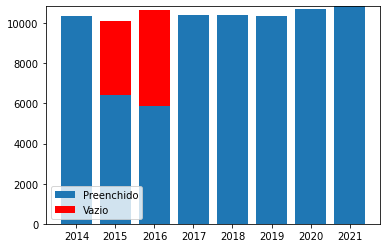

In [ ]:
x = df_cartola['ano'].unique()
x.sort()

labels = ['Preenchido', 'Vazio']

y1 = df_cartola.groupby(['ano'])['posicao'].count()
print('Valores preenchidos')
print(y1)
print()

y2 = df_cartola.groupby('ano', dropna=False).agg({'posicao': lambda a : a.isnull().sum()})['posicao']
print('Valores não preenchidos')
print(y2)
print()


plt.bar(x, y1)
plt.bar(x, y2, bottom=y1, color='r')
plt.xticks(x)
plt.legend(labels)
plt.show()


In [ ]:
# Removendo as edições de 2015 e 2016
df_temp = df_cartola.drop(df_cartola[(df_cartola['ano'] == 2015) | 
                                     (df_cartola['ano'] == 2016)].index)
print(f'Linhas de df_cartola:    {df_cartola.shape[0]}')
print(f'Linhas após remoção:  {df_temp.shape[0]}')
print()
df_cartola = df_temp

Linhas de df_cartola:    83874
Linhas após remoção:  63095



In [ ]:
# Procurando a linha da edição de 2014 que contém o jogador sem posição
df_cartola.loc[(df_cartola['ano'] == 2014) & (df_cartola['posicao'].isnull())]

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube
24601,73948,7,NaN,3.02,8.64,-0.36,2014,NaN


Pode ser observador que o jogador não tem posição nem clube associado, logo esta linha será desconsiderada.

In [ ]:
# Removendo linha do jogador sem clube e sem posição de 2014
df_temp = df_cartola.drop(df_cartola[(df_cartola['ano'] == 2014) & 
                                     (df_cartola['posicao'].isnull()) & 
                                     (df_cartola['clube'].isnull())].index)
print(f'Linhas de df_cartola:    {df_cartola.shape[0]}')
print(f'Linhas após remoção:  {df_temp.shape[0]}')
print()
df_cartola = df_temp

Linhas de df_cartola:    63095
Linhas após remoção:  63094



In [ ]:
# Procurando a linha de jogador sem clube
df_cartola.loc[df_cartola['clube'].isnull()]

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube


Este problema foi resolvido quando a linha da edição de 2014 do jogador sem posição foi excluída.

### Passo 2
Como são 20 clubes em cada edição do Brasileirão e estes clubes jogam 2 turnos, logo cada clube joga 38 rodadas. Portanto, devem existir 38 rodadas por clube em cada edição do Brasileiro.

In [ ]:
# Verificar se algum clube possui menos de 38 partidas em alguma edição do campeonato
df_group = df_cartola.groupby(['ano', 'clube'])['rodada'].nunique().to_frame()
df_group[df_group['rodada'] <= 37]

rodada
ano  clube         
2014 ATL-MG      37
     BAH         37
     BOT         37
     CHA         36
     GOI         37
...             ...
2021 PAL         37
     RBB         34
     SAN         36
     SAO         34
     SPO         35

[75 rows x 1 columns]

Podemos observar que existem clubes com menos de 38 rodadas nas edições do Brasileirão.

Vamos analisar:
1. Deve existir um total de 38 (rodadas) * 20 (times) = 760 participações
2. Cada clube deve jogar 38 rodadas por edição do Brasileirão. Vamos avaliar o percentual de dados que temos sobre as participações dos clubes por edição, visto que foi observado acima que nem todos os clubes possuem informações para todas os jogos das edições que participaram.

In [ ]:
# Contabilizando o total de participações por edição do Brasileirão
df_group.reset_index(inplace=True)
x = df_group['ano'].unique()
x.sort()

rodadas = 0
for ano in x:
  df_temp = df_group.loc[df_group['ano'] == ano]
  soma = df_temp['rodada'].sum()
  print(f'ano: {ano} ==> rodadas: {soma} ==> percentual: {(soma/760)*100}')

  rodadas += soma

print()
print('Total de participações juntando todas as edições')
print(f'{(rodadas/(len(x)*760)*100)}')

ano: 2014 ==> rodadas: 750 ==> percentual: 98.68421052631578
ano: 2017 ==> rodadas: 750 ==> percentual: 98.68421052631578
ano: 2018 ==> rodadas: 746 ==> percentual: 98.15789473684211
ano: 2019 ==> rodadas: 743 ==> percentual: 97.76315789473684
ano: 2020 ==> rodadas: 690 ==> percentual: 90.78947368421053
ano: 2021 ==> rodadas: 698 ==> percentual: 91.84210526315789

Total de participações juntando todas as edições
95.98684210526316


Nenhuma das edições tem dados de todos as rodadas e os anos de 2020 e 2021 são os que tem menor percentual de informação, porém com mais de 90%, o que é um percentual bem elevado.

Do total de participações possíveis, menos de 5% não estão presentes, o que representa um valor bem pequeno.

In [ ]:
# Contabilizando o percentual de dados que temos de cada clube nas edições do Brasileirão
df_rodada_edicao = df_group.groupby(['clube']).agg({'ano': 'count', 'rodada': 'sum'}).reset_index()

for index, row in df_rodada_edicao.iterrows():
  print(f'clube ==> {row["clube"]} ==> rodadas: {row["rodada"]} ==> edições:'\
        f'{row["ano"]} ==> percentual: {(row["rodada"]/(row["ano"]*38))*100}')

clube ==> AME-MG ==> rodadas: 74 ==> edições:2 ==> percentual: 97.36842105263158
clube ==> ATL-GO ==> rodadas: 107 ==> edições:3 ==> percentual: 93.85964912280701
clube ==> ATL-MG ==> rodadas: 220 ==> edições:6 ==> percentual: 96.49122807017544
clube ==> ATL-PR ==> rodadas: 218 ==> edições:6 ==> percentual: 95.6140350877193
clube ==> AVA ==> rodadas: 76 ==> edições:2 ==> percentual: 100.0
clube ==> BAH ==> rodadas: 215 ==> edições:6 ==> percentual: 94.2982456140351
clube ==> BOT ==> rodadas: 184 ==> edições:5 ==> percentual: 96.84210526315789
clube ==> CEA ==> rodadas: 146 ==> edições:4 ==> percentual: 96.05263157894737
clube ==> CHA ==> rodadas: 182 ==> edições:5 ==> percentual: 95.78947368421052
clube ==> COR ==> rodadas: 214 ==> edições:6 ==> percentual: 93.85964912280701
clube ==> CRI ==> rodadas: 38 ==> edições:1 ==> percentual: 100.0
clube ==> CRU ==> rodadas: 150 ==> edições:4 ==> percentual: 98.68421052631578
clube ==> CSA ==> rodadas: 38 ==> edições:1 ==> percentual: 100.0
clu

Pode ser observado que somente Cuiabá e o Juventude tem percentual abaixo de 90%, respectivamente 86,84% e 89,47%. São valores bem elevados e muito provavelmente ficaram abaixo de 90%, por terem participado de somente 1 edição.

### Passo 3

Deve existir pelo menos 11 jogadores por rodada por clube.

In [ ]:
# Verificando se algum clube em alguma rodada possui menos de 11 jogadores com indicadores.
df_temp = df_cartola.groupby(['ano', 'clube', 'rodada'])['jogador_id'].nunique().to_frame()
df_temp[df_temp['jogador_id'] < 11]

,,,jogador_id
ano,clube,rodada,
2020,SAN,10,5


Somente um clube possuiu menos de 11 jogadores em uma rodada, o que é excelente, pois poderemos criar os 3 indicadores de força e o indicador de valor com bastante informação e precisão.

### Passo 4

Cada edição do Brasileirão deve conter 20 times.

In [ ]:
# Contando quantos clubes existem em cada edição do Brasileirão
df_cartola.groupby(['ano'])['clube'].nunique()

ano
2014    20
2017    20
2018    20
2019    20
2020    20
2021    20
Name: clube, dtype: int64

Todas as edições possuem 20 clubes, então temos dados de todos os clubes em todas as edições.

### Passo 5

Só deve existir uma participação do jogador por rodada do campeonato brasileiro.

In [ ]:
# Verificando se algum jogador participou de mais uma vez na mesma rodada.
df_temp = df_cartola.groupby(['jogador_id', 'ano', 'rodada'])['clube'].count().to_frame()
df_temp = df_temp[df_temp['clube'] > 1]
df_temp

,,,clube
jogador_id,ano,rodada,


Pode ser observado que não existe jogador participando mais de uma vez de uma mesma rodada numa edição do Brasileirão.

### Conclusão

Podemos observar pelas análises acima que:

*   Existiam 16 linhas repetidas indicando que o mesmo jogador tinha valores repetidos e estes foram excluídos.
*   Para os anos de 2014, 2015 e 2016, a variável **posicao** tinha valores vazios, isso compromete a criação dos 3 indicadores de força e o indicador de valor para um clube, visto que não seria possível associar a posição do jogador ao jogador.
*   Na variável **clube**, existia 1 linha com valor vazio. Esta linha era comum com o problema apontado no bullet acima para o ano de 2014. Com a exclusão explicada no bullet acima esse problema foi resolvido.
*   Nem todos os clubes possuem dados para todas as rodadas em todas as edições do Brasileirão. 
*   Em 2020, o Santos não possui pelo menos 11 jogadores na rodada 10.

<br />

Infelizmente, o CartolaFC não disponibiliza dados históricos, portanto esses dados não estão mais disponíveis para coleta. Uma possível fonte de consulta, o site [CartolaFCBrasil](https://www.cartolafcbrasil.com.br/) também está com os dados incompletos e iguais aos dados utilizados neste trabalho.

<br />

A falta destes dados é um fato que podemos atenuar bastante com: (1) a aplicação de algumas técnicas matemáticas para estimar os valores faltantes e (2) com a forma de construção dos indicadores de ataque, meio-campo, defesa e valor de cada clube.

*   Clubes que não possuírem informações de seus jogadores em uma determinada rodada terão seus indicadores de força como a média do respectivo indicador até a rodada sendo calculada. Caso as informações faltantes sejam da primeira rodada, serão copiados os indicadores da rodada seguinte ou até encontrar a primeira rodada com indicadores.

*   Cada clube irá possuir 3 indicadores que representam suas forças de ataque, meio-campo e defesa construídos a partir da média da pontuação dos jogadores por rodada e 1 indicador de valor, construído a partir da média do preço dos jogadores de um time por rodada. Ou seja, clubes com menos de 11 jogadores em uma rodada não possuirão uma média tão diferente de clubes com mais de 11 jogadores por rodada. 

Além das técnicas utilizadas, os valores incompletos representam uma pequena parte do todo, menos de 5% da base total.

> Ex: Cada clube joga 38 partidas por edição do Brasileirão e toda edição é composta por 20 clubes. A base de dados utilizada neste trabalho possui 6 edições do campeonato Brasileiro, portanto o total de participações deve ser 38 * 20 * 6, que é igual a 4560. Deste total, menos de 5% não possuem dados.
<br />
<br />

Em data science e machine learning, trabalhar com dados incompletos é algo comumente enfrentado pelos cientistas de dados que precisam utilizar de técnicas matemáticas para atenuar estes problemas, assim como as técnicas aplicadas neste trabalho.

## Brasileirão

A seguir serão realizadas algumas análises exploratórias para conhecimento dos dados e ajustes de possíveis problemas.

1.   Profile dos dados utilizando a biblioteca pandas profiling.
2.   Quantidade de rodadas por edição do campeonato (38 no total).
3.   Quantidade de partidas por rodada por edição do campeonato (10 partidas).
4.   Quantidade de clubes por edição do campeonato (20 no total).

### Passo 1

In [ ]:
# Rodando o profile em df_brasileirao
profile = ProfileReport(df_brasileirao, title='Relatório de perfil das variáveis', html={'style': {'full_width': True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Todas as variáveis estão sem valores nulos e contém valores de média, máximo, mínimo e valores zerados coerentes com a sua natureza.

### Passo 2
Devem existir 38 rodadas por edição do Brasileirão.

In [ ]:
# Verificar se alguma edição do Brasileirão tem menos de 38 partidas
df_group = df_brasileirao.groupby(['ano'])['rodada'].nunique().to_frame()
df_group

,rodada
ano,
2014,38
2015,38
2016,38
2017,38
2018,38
2019,38
2020,38
2021,38


### Passo 3
Toda rodada do Brasileirão é composta por 10 partidas.

In [ ]:
# Verificando se alguma rodada possui menos de 10 partidas.
df_temp = df_brasileirao.groupby(['ano', 'rodada'])['mandante'].nunique().to_frame()
df_temp[df_temp['mandante'] <= 9]

,,mandante
ano,rodada,
2016,38,9


Na rodada 38 da edição do Brasileirão de 2016, existem dados para somente 9 partidas. Como a edição do 2016 será excluída pelos motivos explicados em `Análise Exploratória > Cartola > Passo 1`, este problema não terá impacto no trabalho.



### Passo 4
Toda edição do Brasileirão deve conter 20 clubes. Para fazer esta contagem, será utilizado o campo mandante, como cada clube joga partidas em casa e fora de casa, não há necessidade de avaliar o campo visitante também.

In [ ]:
# Verificando se alguma edição não possui 20 clubes
df_brasileirao.groupby(['ano'])['mandante'].unique().apply(lambda x: x.size)

ano
2014    20
2015    20
2016    20
2017    20
2018    20
2019    20
2020    20
2021    20
Name: mandante, dtype: int64

### Conclusão

O único problema encontrado na base do Brasileirão foi que na edição de 2016, a rodada 38 possui somente 9 partidas. Como essa edição será excluída pelos motivos explicados em `Análise Exploratória > Cartola > Passo 1`, este problema não terá impacto no trabalho.

Todas as outras análises mostraram que os dados estão de acordo com o esperado.

# Tratamento pós análise exploratória

## Cartola

Após a análise exploratória, os 3 indicadores de força de um clube e o indicador de valor serão criados para o dataframe do CartolaFC.

O problema identificado na análise exploratória de falta de informação para determinadas rodadas de determinados clubes de determinadas edições será corrigido nesta etapa com uma regra simples de estimativa de valores.

### Geração dos indicadores ataque, meio-campo, defesa e valor
Com o dataset ***df_cartola*** limpo e organizado, farei a geração dos indicadores de ataque, meio-campo, defesa e valor. Será necessário modificar o grão do ***df_cartola*** de jogador-rodada para clube-rodada em cada edição do Brasileirão. Dessa forma, cada clube em cada rodada do Brasileirão possuirá os indicadores de ataque, meio-campo, defesa e valor.
> Ex:

nome_clube | ataque | meio_campo | defesa | valor | rodada | ano
---------- | ------ | ---------- | ------ | ----- | ------ | ---
VAS        | 123    | 234        | 123    | 678   | 2      | 2020
FLA        | -123   | -234       | -123   | 456   | 2      | 2020


O indicador de ataque chamará **ataque** e receberá a média da pontuação do jogadores com a coluna **posicao** igual a ata do mesmo clube/rodada/ano.

O indicador de meio-campo chamará **meio_campo** e receberá a média da pontuação do jogadores com a coluna **posicao** igual a mei do mesmo clube/rodada/ano.

O indicador de defesa chamará **defesa** e receberá a média da pontuação do jogadores com a coluna **posicao** iguais a zag ou lat ou gol do mesmo clube/rodada/ano.

O indicador de valor chamará **valor** e receberá a média do preço dos jogadores de um mesmo clube por rodada/ano.

In [ ]:
# Listando df_cartola
df_cartola.head(5)

,jogador_id,rodada,posicao,pontos,preco,preco_variacao,ano,clube
0,36443,1,gol,5.0,10.60,1.60,2014,INT
1,36443,2,gol,-3.0,8.27,-2.33,2014,INT
2,36443,3,gol,-2.6,6.81,-1.46,2014,INT
3,36443,4,gol,4.0,7.96,1.15,2014,INT
4,36443,5,gol,5.0,8.61,0.65,2014,INT


In [ ]:
# Transformando o dataframe df_cartola e calculando os novos indicadores
df_cartola = df_cartola.sort_values(by=['ano', 'rodada', 'clube'])
df_cartola = df_cartola.reset_index(drop=True)

agg_dict = {}
for index, row in df_cartola.iterrows():
  compute_indicators_cartola(agg_dict, row)

agg_list = dict_to_list(agg_dict)
df_cartola = list_to_dataframe(agg_list, ['ano', 'rodada', 'clube', 'soma_ataque',
                                          'qtd_ataque', 'soma_meio_campo', 
                                          'qtd_meio_campo', 'soma_defesa', 
                                          'qtd_defesa', 'soma_valor', 'qtd_valor'])

In [ ]:
# Criando os indicadores de ataque, meio_campo, defesa e valor
df_cartola['ataque'] = df_cartola.apply(
    lambda row: 0 if (row['qtd_ataque'] == 0)
                  else row['soma_ataque']/row['qtd_ataque'], axis=1)

df_cartola['meio_campo'] = df_cartola.apply(
    lambda row: 0 if (row['qtd_meio_campo'] == 0) 
                  else row['soma_meio_campo']/row['qtd_meio_campo'], axis=1)

df_cartola['defesa'] = df_cartola.apply(
    lambda row: 0 if (row['qtd_defesa'] == 0)
                  else row['soma_defesa']/row['qtd_defesa'], axis=1)

df_cartola['valor'] = df_cartola.apply(
    lambda row: 0 if (row['qtd_valor'] == 0)
                  else row['soma_valor']/row['qtd_valor'], axis=1)

df_cartola

,ano,rodada,clube,soma_ataque,qtd_ataque,soma_meio_campo,qtd_meio_campo,soma_defesa,qtd_defesa,soma_valor,qtd_valor,ataque,meio_campo,defesa,valor
0,2014,1,ATL-MG,2.6,5,1.9,3,34.1,5,132.24,13,0.520000,0.633333,6.820000,10.172308
1,2014,1,ATL-PR,2.0,3,11.6,5,36.8,6,111.66,14,0.666667,2.320000,6.133333,7.975714
2,2014,1,BAH,11.1,4,13.9,5,1.9,5,84.00,14,2.775000,2.780000,0.380000,6.000000
3,2014,1,BOT,-4.7,3,7.3,5,5.8,6,126.78,14,-1.566667,1.460000,0.966667,9.055714
4,2014,1,CHA,5.3,4,3.3,5,31.8,5,91.18,14,1.325000,0.660000,6.360000,6.512857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4372,2021,38,PAL,17.6,4,6.0,6,45.3,6,34.63,16,4.400000,1.000000,7.550000,2.164375
4373,2021,38,RBB,21.3,7,8.1,3,21.1,5,130.27,15,3.042857,2.700000,4.220000,8.684667
4374,2021,38,SAN,14.9,5,4.6,5,1.2,6,82.94,16,2.980000,0.920000,0.200000,5.183750
4375,2021,38,SAO,4.0,5,4.0,2,8.2,7,85.21,14,0.800000,2.000000,1.171429,6.086429


In [ ]:
# Removendo colunas que não serão utilizadas
df_cartola.drop(columns=['soma_ataque', 'qtd_ataque','soma_meio_campo', 'qtd_meio_campo',
                         'soma_defesa', 'qtd_defesa', 'soma_valor', 'qtd_valor'], inplace=True)

df_cartola 

,ano,rodada,clube,ataque,meio_campo,defesa,valor
0,2014,1,ATL-MG,0.520000,0.633333,6.820000,10.172308
1,2014,1,ATL-PR,0.666667,2.320000,6.133333,7.975714
2,2014,1,BAH,2.775000,2.780000,0.380000,6.000000
3,2014,1,BOT,-1.566667,1.460000,0.966667,9.055714
4,2014,1,CHA,1.325000,0.660000,6.360000,6.512857
...,...,...,...,...,...,...,...
4372,2021,38,PAL,4.400000,1.000000,7.550000,2.164375
4373,2021,38,RBB,3.042857,2.700000,4.220000,8.684667
4374,2021,38,SAN,2.980000,0.920000,0.200000,5.183750
4375,2021,38,SAO,0.800000,2.000000,1.171429,6.086429


### Completando informações faltantes de indicadores por rodada dos clubes

Os clubes no dataframe ***df_cartola*** que não possuírem informações em uma determinada rodada terão seus indicadores de força e de valor criados de acordo com a seguinte regra:

* O valor do indicador será a média do respectivo indicador até a rodada sendo calculada. Caso as informações faltantes sejam da primeira rodada, serão copiados os indicadores da rodada seguinte ou até encontrar a primeira rodada com indicadores.

> Ex: 

clube | rodada | ataque | meio_campo
----- | ------ | ------ | ----------
VAS   | 1      | 20     | 30
VAS   | 2      | 30     | 34
PAL   | 3      | 20     | 12

A rodada 3 para o clube VAS não existe, aplicando a regra acima, o indicador ataque receberá o valor 25, pois é a média das rodadas 1 e 2. A mesma coisa para o indicador meio_campo, receberá o valor 15.

O clube PAL não possui as rodadas 1 e 2, aplicando a regra acima, o indicador ataque na rodada 1 receberá o valor 15, pois a rodada 1 é a primeira e o primeiro indicador existente é o da rodada 3. A mesma coisa acontecerá com o indicador meio_campo, receberá o valor 10. Os valores para rodada 2 serão obtidos como explicado na exemplificação do clube VAS.

Tabela final com os valores preenchidos.

clube | rodada | ataque | meio_campo
----- | ------ | ------ | ----------
VAS   | 1      | 20     | 30
VAS   | 2      | 30     | 34
VAS   | 3      | 25     | 32
PAL   | 1      | 20     | 12
PAL   | 2      | 20     | 12
PAL   | 3      | 20     | 12

In [ ]:
# Completando informações de df_cartola
df_cartola = df_cartola.sort_values(by=['ano', 'clube', 'rodada'])
df_cartola = df_cartola.reset_index(drop=True)

df_temp = fill_indicators(df_cartola)
print(f'df_cartola antes completação ==> linhas: {df_cartola.shape[0]} / colunas: {df_cartola.shape[1]}')
print(f'df_cartola após completação  ==> linhas: {df_temp.shape[0]} / colunas: {df_temp.shape[1]}')
df_cartola = df_temp

df_cartola antes completação ==> linhas: 4377 / colunas: 7
df_cartola após completação  ==> linhas: 4560 / colunas: 7


## Brasileirão

Os anos de 2015 e 2016 precisam ser excluídos porque o dataframe do CartolaFC não tem essas informações como explicado na seção `Análise exploratória > Cartola > Passo 1`.

Outra modificação importante é equalizar os valores das colunas **mandante** e **visitante** com os valores utilizados no dataframe do CartolaFC.

### Exclusão das edições de 2015 e 2016

In [ ]:
# Removendo as edições de 2015 e 2016
df_temp = df_brasileirao.drop(
    df_brasileirao[(df_brasileirao['ano'] == 2015) | (df_brasileirao['ano'] == 2016)].index)

print(f'Linhas de df_brasileirao: {df_brasileirao.shape[0]}')
print(f'Linhas após remoção:      {df_temp.shape[0]}')
print()
df_brasileirao = df_temp

Linhas de df_brasileirao: 3039
Linhas após remoção:      2280



### Equalizar os valores das colunas **mandante** e **visitante** com os valores utilizados no dataframe CartolaFC

Um arquivo xlsx foi criado manualmente para fazer a tradução do nome do clube para abreviação com valor semântico, assim como feito no dataframe do CartolaFC.

As seguintes operações foram realizadas na criação do arquivo de tradução:
*   Coletado todos os clubes presentes na coluna mandante de ***df_brasileirao***.
*   Convertido os valores todos para maiúsculo e criada a coluna **nome_clube** com esses valores.
*   Criada a coluna **abreviacao** com o valora da abreviacao de cada clube.
*   Gerado o arquivo clubes_traducao.xlsx.

Este arquivo será carregado para o dataframe ***df_clubes_traducao***.

Após o carregamento do arquivo de tradução no dataframe ***df_clubes_traducao***, será feito o join do dataframe ***df_brasileirao*** com o ***df_clubes_traducao***. Esta operação será realizada duas vezes, a primeira para traduzir a coluna **mandante** e a segunda para traduzir a coluna **visitante**.

As colunas de join e colunas vindas de ***df_clubes_traducao*** serão deletadas após as operações de join.

In [ ]:
# Lendo arquivo de clubes para tradução
df_clubes_traducao = pd.read_excel('/content/drive/MyDrive/cursos/pos-puc-minas/'\
                                   'projeto-final/dados-brasileirao/clubes_traducao.xlsx')

df_clubes_traducao.head(5)

,nome_clube,abreviacao
0,FLUMINENSE,FLU
1,INTERNACIONAL,INT
2,CHAPECOENSE,CHA
3,BAHIA,BAH
4,SAO PAULO,SAO


In [ ]:
# Colocando em maiúsculo o nome dos clubes nas colunas mandante e visitante
df_brasileirao['mandante'] = df_brasileirao['mandante'].apply(lambda x: x.upper())
df_brasileirao['visitante'] = df_brasileirao['visitante'].apply(lambda x: x.upper())

df_brasileirao.head(3)

,rodada,mandante,visitante,vencedor,placar_mandante,placar_visitante,ano,mandante_vitorias,mandante_derrotas,mandante_empates,visitante_vitorias,visitante_derrotas,visitante_empates,mandante_total_gols,visitante_total_gols,mandante_gols_feitos_casa,mandante_gols_sofridos_casa,visitante_gols_feitos_fora_casa,visitante_gols_sofridos_fora_casa,mandante_seq_vitorias_casa,mandante_seq_derrotas_casa,visitante_seq_vitorias_fora,visitante_seq_derrotas_fora
0,1,FLUMINENSE,FIGUEIRENSE,1,3,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,INTERNACIONAL,VITORIA,1,1,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,CHAPECOENSE,CORITIBA,2,0,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Join df_brasileirao com df_clubes_traducao
df_temp = df_brasileirao.merge(df_clubes_traducao, how='left', left_on='mandante', right_on='nome_clube')
df_temp = df_temp.merge(df_clubes_traducao, how='left', left_on='visitante', right_on='nome_clube')
print(f'Linhas de df_brasileirao:              {df_brasileirao.shape[0]}')
print(f'Linhas de df_clubes_traducao:          {df_clubes_traducao.shape[0]}')
print(f'Linhas de após joins:                  {df_temp.shape[0]}')
print(f'Quantidade de linhas vazias após join: {df_temp["abreviacao_x"].isnull().sum()}')
print()
df_brasileirao = df_temp

Linhas de df_brasileirao:              2280
Linhas de df_clubes_traducao:          32
Linhas de após joins:                  2280
Quantidade de linhas vazias após join: 0



In [ ]:
# Deletando as colunas de join e colunas de df_clubes_traducao
df_brasileirao.drop(columns=['nome_clube_x', 'nome_clube_y', 'mandante', 'visitante'], inplace=True)

# Renomeando a coluna abreviacao_x para mandante e abreviacao_y para visitante
df_brasileirao.rename(columns={'abreviacao_x': 'mandante', 
                               'abreviacao_y': 'visitante'}, inplace=True)

df_brasileirao.head(3)

,rodada,vencedor,placar_mandante,placar_visitante,ano,mandante_vitorias,mandante_derrotas,mandante_empates,visitante_vitorias,visitante_derrotas,visitante_empates,mandante_total_gols,visitante_total_gols,mandante_gols_feitos_casa,mandante_gols_sofridos_casa,visitante_gols_feitos_fora_casa,visitante_gols_sofridos_fora_casa,mandante_seq_vitorias_casa,mandante_seq_derrotas_casa,visitante_seq_vitorias_fora,visitante_seq_derrotas_fora,mandante,visitante
0,1,1,3,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,FLU,FIG
1,1,1,1,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,INT,VIT
2,1,2,0,0,2014,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,CHA,CTB


# Join de df_cartola com df_brasileirao
Com os dataframes ***df_cartola*** e ***df_brasileirao*** limpos e organizados, posso juntá-los em um único dataframe chamado ***df_full***. Este dataframe final será utilizado para aplicar os modelos de machine learning com o objetivo de (1) classificar o resultado dos jogos em 3 grupos, vitória, empate e derrota e (2) comparar a qualidade da previsão dos modelos.

Dois joins serão realizados entre o ***df_brasileirao*** e ***df_cartola***, o primeiro para pegar os dados do cartola dos mandantes e o segundo para pegar os dados do cartola dos visitantes.

Após o join as seguintes operações serão realizadas:
*   As colunas **clube_x** e **clube_y** serão deletadas.
*   As colunas do dataframe ***df_full*** serão renomeadas conforme tabela abaixo. Destaque para a coluna **resultado_partida** que será a variável alvo dos modelos de machine learning, é nela que estará o resultado da partida, na qual os valores 0, 1 e 2 representam respectivamente derrota do mandante, vitória do mandante e empate.

de           | para
------------ | -------------------
ataque_x     | mandante_ataque
meio_campo_x | mandante_meio_campo
defesa_x     | mandante_defesa
valor_x      | mandante_valor
ataque_y     | visitante_ataque
meio_campo_y | visitante_meio_campo
defesa_y     | visitante_defesa
valor_y      | visitante_valor
vencedor     | resultado_partida

In [ ]:
# Join df_brasileirao com df_cartola
df_temp = df_brasileirao.merge(df_cartola, how='left', 
                               left_on=['ano', 'rodada', 'mandante'], 
                               right_on=['ano', 'rodada', 'clube'])

df_temp = df_temp.merge(df_cartola, how='left', 
                        left_on=['ano', 'rodada', 'visitante'], 
                        right_on=['ano', 'rodada', 'clube'])

print(f'Linhas de df_brasileirao:                                     '\
      f'{df_brasileirao.shape[0]}')

print(f'Linhas de df_cartola:                                         '\
      f'{df_cartola.shape[0]}')

print(f'Linhas de após joins:                                         '\
      f'{df_temp.shape[0]}')

print(f'Quantidade de linhas vazias após join olhandos os mandantes:  '\
      f'{df_temp["clube_x"].isnull().sum()}')

print(f'Quantidade de linhas vazias após join olhandos os visitantes: '\
      f'{df_temp["clube_y"].isnull().sum()}')

print()
df_full = df_temp

Linhas de df_brasileirao:                                     2280
Linhas de df_cartola:                                         4560
Linhas de após joins:                                         2280
Quantidade de linhas vazias após join olhandos os mandantes:  0
Quantidade de linhas vazias após join olhandos os visitantes: 0



In [ ]:
# Deletando as colunas de join
df_full.drop(columns=['clube_x', 'clube_y'], inplace=True)

# Renomeando as colunas
df_full.rename(columns={'ataque_x': 'mandante_ataque', 
                        'meio_campo_x': 'mandante_meio_campo',
                        'defesa_x': 'mandante_defesa',
                        'valor_x': 'mandante_valor',
                        'ataque_y': 'visitante_ataque', 
                        'meio_campo_y': 'visitante_meio_campo',
                        'defesa_y': 'visitante_defesa',
                        'valor_y': 'visitante_valor',
                        'vencedor': 'resultado_partida'}, inplace=True)

# Reordenando as colunas
df_full = df_full[['ano', 'rodada', 'mandante', 'visitante', 'placar_mandante', 
                   'placar_visitante', 'mandante_vitorias', 'mandante_derrotas',
                   'mandante_empates', 'visitante_vitorias', 'visitante_derrotas',
                   'visitante_empates', 'mandante_total_gols', 'visitante_total_gols',
                   'mandante_gols_feitos_casa', 'mandante_gols_sofridos_casa',
                   'visitante_gols_feitos_fora_casa', 'visitante_gols_sofridos_fora_casa', 
                   'mandante_seq_vitorias_casa', 'mandante_seq_derrotas_casa', 
                   'visitante_seq_vitorias_fora', 'visitante_seq_derrotas_fora', 
                   'mandante_ataque', 'mandante_meio_campo', 'mandante_defesa', 
                   'mandante_valor', 'visitante_ataque', 'visitante_meio_campo',
                   'visitante_defesa', 'visitante_valor', 'resultado_partida']]

df_full

,ano,rodada,mandante,visitante,placar_mandante,placar_visitante,mandante_vitorias,mandante_derrotas,mandante_empates,visitante_vitorias,visitante_derrotas,visitante_empates,mandante_total_gols,visitante_total_gols,mandante_gols_feitos_casa,mandante_gols_sofridos_casa,visitante_gols_feitos_fora_casa,visitante_gols_sofridos_fora_casa,mandante_seq_vitorias_casa,mandante_seq_derrotas_casa,visitante_seq_vitorias_fora,visitante_seq_derrotas_fora,mandante_ataque,mandante_meio_campo,mandante_defesa,mandante_valor,visitante_ataque,visitante_meio_campo,visitante_defesa,visitante_valor,resultado_partida
0,2014,1,FLU,FIG,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6.425000,1.360000,6.240000,13.507143,2.133333,0.316667,-0.260000,5.042857,1
1,2014,1,INT,VIT,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.350000,4.871429,5.340000,11.063571,1.050000,1.050000,1.650000,6.345714,1
2,2014,1,CHA,CTB,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.325000,0.660000,6.360000,6.512857,2.550000,1.525000,5.471429,8.301538,2
3,2014,1,BAH,CRU,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2.775000,2.780000,0.380000,6.000000,3.366667,3.316667,1.900000,8.574286,0
4,2014,1,SAO,BOT,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5.050000,3.125000,10.900000,14.990000,-1.566667,1.460000,0.966667,9.055714,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2275,2021,38,AME-MG,SAO,2,0,12,11,14,11,11,15,39,31,20,11,13,22,1,0,0,1,7.340000,2.700000,6.385714,6.066875,0.800000,2.000000,1.171429,6.086429,1
2276,2021,38,RBB,INT,1,0,13,10,14,12,13,12,54,44,27,20,15,19,0,0,0,5,3.042857,2.700000,4.220000,8.684667,-1.650000,0.500000,-0.312500,6.300625,1
2277,2021,38,JUV,COR,1,0,10,14,13,15,10,12,35,40,18,15,14,17,3,0,0,3,1.866667,3.285714,7.428571,4.716471,-0.200000,-0.162500,-0.100000,5.921333,1
2278,2021,38,GRE,ATL-MG,4,3,11,19,7,26,5,6,40,64,25,18,22,17,3,0,0,0,7.975000,3.750000,1.860000,6.104615,3.100000,4.116667,4.040000,4.782500,1


In [ ]:
# Exibindo do shape de df_full
df_full.shape

(2280, 31)

# Modelos de machine learning
Nesta seção serão aplicados os modelos de machine learning abaixo tendo como target a coluna **resultado_partida** e como features as colunas **placar_mandante**, **placar_visitante**, **mandante_vitorias**, **mandante_derrotas**, **mandante_empates**, **visitante_vitorias**, **visitante_derrotas**, **visitante_empates**,	**mandante_total_gols**, **visitante_total_gols**, **mandante_gols_feitos_casa**, **mandante_gols_sofridos_casa**, **visitante_gols_feitos_fora_casa**, **visitante_gols_sofridos_fora_casa**, **mandante_seq_vitorias_casa**, **mandante_seq_derrotas_casa**, **visitante_seq_vitorias_fora**, **visitante_seq_derrotas_fora**, **mandante_ataque**, **mandante_meio_campo**, **mandante_defesa**, **mandante_valor**, **visitante_ataque**, **visitante_meio_campo**, **visitante_defesa** e **visitante_valor**.
*   Naive Bayes
*   Decision Tree
*   KNN
*   Random Forest

<br>

O target possui os valores:

valor | significado
----- | -----------
0     | vitória do visitante
1     | vitória do mandante
2     | empate

<br>

Uma etapa importante antes da aplicação dos modelos de machine learning é a normalização dos dados. A importância desta etapa está em colocar os dados em uma escala comum para que nenhum desses dados influencie de forma dominante no resultado da previsão. Entretanto, os valores das features estão próximos em uma mesma escala, como pode ser observado nos profiles aplicados nos dataframes ***df_cartola*** `Análise exploratória > Cartola > Passo 1` e ***df_brasileirao*** `Análise exploratória > Brasileirão > Passo 1`. Logo, esse processo de normalização não será necessário nos dados.

Antes de aplicar os modelos de machine learning, é preciso separar o dataframe ***df_full*** em dados de treinamento e dados de teste. Esta operação será realizada pela função `train_test_split` do pacote sklearn.
Os dados de treinamento e testes serão separados conforme abaixo:

nome da variável | tipo do dado
---------------- | ------------
X_train          | features para treinamento
y_train          | target para treinamento
X_test           | features para teste
y_test           | target para teste

<br>

Após aplicar o modelo de machine learning, a técnica de *cross validation* será utilizada para avaliar a capacidade de generalização do modelo.

O objetivo da técnica de *cross validation* é avaliar o desempenho do modelo de aprendizado de máquina através da capacidade de generalização deste modelo. É muito utilizado para verificar se o modelo não está sobreajustado aos dados de treinamento, ou seja, sofrendo overfitting.

O método *k-fold* de *cross validation* consiste em dividir o conjunto total de dados em k subconjuntos mutuamente exclusivos do mesmo tamanho e, a partir daí, um subconjunto é utilizado para teste e os k-1 restantes são utilizados para estimação dos parâmetros, fazendo-se o cálculo da acurácia do modelo.

Este processo é realizado k vezes alternando de forma circular o subconjunto de teste. Para todos os modelos, será utilizado k = 5 para fazer o *cross validation*.

Agora, podemos aplicar os modelos de machine learning e analisar suas respostas.

## Separação do dataframe em teste e treinamento

In [ ]:
# Separando target e features
target = 'resultado_partida'
features = list(df_full.columns.values[4:-1])

df_full['resultado_partida'].value_counts()

1    1095
2     624
0     561
Name: resultado_partida, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


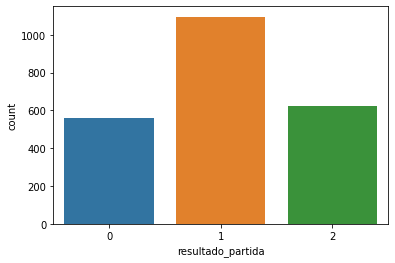

In [ ]:
# Plotando a quantidade de resultados do target.
sns.countplot(df_full['resultado_partida'])

In [ ]:
# Criando dados de teste e treinamento.
X = df_full[features]
y = df_full[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

print(f'X_train => linhas: {X_train.shape[0]} / colunas: {X_train.shape[1]}')
print(f'y_train => linhas: {y_train.count()}')
print()
print(f'X_test  => linhas: {X_test.shape[0]} / colunas: {X_test.shape[1]}')
print(f'y_test  => linhas: {y_test.count()}')

X_train => linhas: 1710 / colunas: 26
y_train => linhas: 1710

X_test  => linhas: 570 / colunas: 26
y_test  => linhas: 570


## Naive Bayes

Aplicação do modelo de machine learning Naive Bayes.

In [ ]:
gnb = GaussianNB()

gnb = gnb.fit(X_train, y_train)

print(f'Acurácia no treinamento: {gnb.score(X_train, y_train)}')
predict = gnb.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test, predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 0.8146198830409357
Acurácia no teste:       0.8122807017543859

              precision    recall  f1-score   support

           0       0.85      0.86      0.86       137
           1       0.88      0.85      0.87       270
           2       0.67      0.71      0.69       163

    accuracy                           0.81       570
   macro avg       0.80      0.81      0.80       570
weighted avg       0.82      0.81      0.81       570



### Matriz de confusão

Matriz de confusão para visualizar a acurácia do modelo.

In [ ]:
# Gerando a matriz de confusão
confusion = confusion_matrix(y_test, predict, labels=[1, 0, 2])
cf = pd.DataFrame(confusion, index=['vitoria', 'derrota', 'empate'], 
                  columns=['vitoria', 'derrota', 'empate'])
cf

,vitoria,derrota,empate
vitoria,229,3,38
derrota,1,118,18
empate,29,18,116


### Cross validation

Aplicação do método k-fold com k = 5 para fazer o *cross validation*.

In [ ]:
scores = cross_val_score(gnb, X_train, y_train, cv=5)
print(f'Valores cross validation: {scores}')
print(f'Média                   : {scores.mean()}')
print(f'Desvio padrão           : {scores.std()}')

Valores cross validation: [0.79532164 0.80116959 0.81871345 0.79824561 0.74269006]
Média                   : 0.7912280701754387
Desvio padrão           : 0.025597741085659976


## Decision Tree
Aplicação do modelo de machine learning Decision Tree.

In [ ]:
dtc = DecisionTreeClassifier(random_state=0)
dtc = dtc.fit(X_train, y_train)

print(f'Acurácia no treinamento: {dtc.score(X_train, y_train)}')
predict = dtc.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 1.0
Acurácia no teste:       1.0

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       137
           1       1.00      1.00      1.00       270
           2       1.00      1.00      1.00       163

    accuracy                           1.00       570
   macro avg       1.00      1.00      1.00       570
weighted avg       1.00      1.00      1.00       570



### Matriz de confusão

Matriz de confusão para visualizar a acurácia do modelo.

In [ ]:
# Gerando a matriz de confusão
confusion = confusion_matrix(y_test, predict, labels=[1, 0, 2])
cf = pd.DataFrame(confusion, index=['vitoria', 'derrota', 'empate'],
                  columns=['vitoria', 'derrota', 'empate'])
cf

,vitoria,derrota,empate
vitoria,270,0,0
derrota,0,137,0
empate,0,0,163


### Cross validation

Aplicação do método k-fold com k = 5 para fazer o cross validation.

In [ ]:
scores = cross_val_score(dtc, X_train, y_train, cv=5)
print(f'Valores cross validation: {scores}')
print(f'Média                   : {scores.mean()}')
print(f'Desvio padrão           : {scores.std()}')

Valores cross validation: [1.         1.         1.         1.         0.99707602]
Média                   : 0.9994152046783625
Desvio padrão           : 0.0011695906432748425


## KNN

Aplicação do modelo de machine learning KNN.

In [ ]:
knn = KNeighborsClassifier()
knn = knn.fit(X_train, y_train)

print(f'Acurácia no treinamento: {knn.score(X_train, y_train)}')
predict = knn.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 0.7894736842105263
Acurácia no teste:       0.6877192982456141

              precision    recall  f1-score   support

           0       0.64      0.72      0.68       137
           1       0.74      0.85      0.79       270
           2       0.60      0.39      0.48       163

    accuracy                           0.69       570
   macro avg       0.66      0.65      0.65       570
weighted avg       0.68      0.69      0.67       570



### Matriz de confusão

Matriz de confusão para visualizar a acurácia do modelo.

In [ ]:
# Gerando a matriz de confusão
confusion = confusion_matrix(y_test, predict, labels=[1, 0, 2])
cf = pd.DataFrame(confusion, index=['vitoria', 'derrota', 'empate'], 
                  columns=['vitoria', 'derrota', 'empate'])
cf

,vitoria,derrota,empate
vitoria,230,18,22
derrota,19,98,20
empate,62,37,64


### Cross validation

Aplicação do método k-fold com k = 5 para fazer o cross validation.

In [ ]:
scores = cross_val_score(knn, X_train, y_train, cv=5)
print(f'Valores cross validation: {scores}')
print(f'Média                   : {scores.mean()}')
print(f'Desvio padrão           : {scores.std()}')

Valores cross validation: [0.65497076 0.67251462 0.64912281 0.68128655 0.67251462]
Média                   : 0.6660818713450293
Desvio padrão           : 0.012041672679516975


## Random Forest

Aplicação do modelo de machine learning Random Forest.

In [ ]:
rfc = RandomForestClassifier()
rfc = rfc.fit(X_train, y_train)

print(f'Acurácia no treinamento: {rfc.score(X_train, y_train)}')
predict = rfc.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 1.0
Acurácia no teste:       0.9789473684210527

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       137
           1       0.98      0.99      0.99       270
           2       0.97      0.95      0.96       163

    accuracy                           0.98       570
   macro avg       0.98      0.98      0.98       570
weighted avg       0.98      0.98      0.98       570



### Matriz de confusão

Matriz de confusão para visualizar a acurácia do modelo.

In [ ]:
# Gerando a matriz de confusão
confusion = confusion_matrix(y_test, predict, labels=[1, 0, 2])
cf = pd.DataFrame(confusion, index=['vitoria', 'derrota', 'empate'], 
                  columns=['vitoria', 'derrota', 'empate'])
cf

,vitoria,derrota,empate
vitoria,268,0,2
derrota,0,135,2
empate,6,2,155


### Cross validation

Aplicação do método k-fold com k = 5 para fazer o cross validation.

In [ ]:
scores = cross_val_score(rfc, X_train, y_train, cv=5)
print(f'Valores cross validation: {scores}')
print(f'Média                   : {scores.mean()}')
print(f'Desvio padrão           : {scores.std()}')

Valores cross validation: [0.98245614 0.95321637 0.97076023 0.97953216 0.98245614]
Média                   : 0.9736842105263157
Desvio padrão           : 0.011095711088310084


## Gráficos de comparação

Geração de gráficos para realizar a comparação da acurácia e das métricas dos modelos de machine learning.

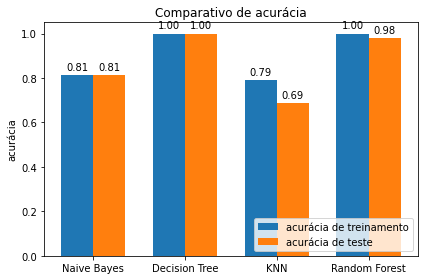

In [123]:
# Gráfico de comparativo de acurácia dos modelos
def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{:.2f}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

acc_train = [0.8146, 1.0, 0.7894, 1.0]
acc_test = [0.8122, 1.0, 0.6877, 0.9789]
labels = ['acurácia de treinamento', 'acurácia de teste']
models = ['Naive Bayes', 'Decision Tree', 'KNN', 'Random Forest']
width = 0.35
x = np.arange(len(acc_train))

fig, ax = plt.subplots()
r1 = ax.bar(x - width/2, acc_train, width, label='acurácia de treinamento')
r2 = ax.bar(x + width/2, acc_test, width, label='acurácia de teste')

ax.set_ylabel('acurácia')
ax.set_title('Comparativo de acurácia')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend(loc='lower right')

autolabel(r1)
autolabel(r2)

fig.tight_layout()
plt.show()

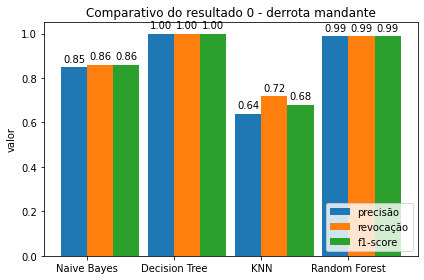

In [124]:
# Gráfico de comparativo de métricas dos modelos resultado 0
precision = [0.85, 1.0, 0.64, 0.99]
recall = [0.86, 1.0, 0.72, 0.99]
f1score = [0.86, 1.0, 0.68, 0.99]
labels = ['precisão', 'revocação', 'f1-score']
models = ['Naive Bayes', 'Decision Tree', 'KNN', 'Random Forest']
width = 0.6/2
x = np.arange(len(precision))

fig, ax = plt.subplots()
r1 = ax.bar(x - width/2, precision, width, label='precisão')
r2 = ax.bar(x + width/2, recall, width, label='revocação')
r3 = ax.bar(x + width + width/2, f1score, width, label='f1-score')

ax.set_ylabel('valor')
ax.set_title('Comparativo do resultado 0 - derrota mandante')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend(loc='lower right')

autolabel(r1)
autolabel(r2)
autolabel(r3)

fig.tight_layout()
plt.show()

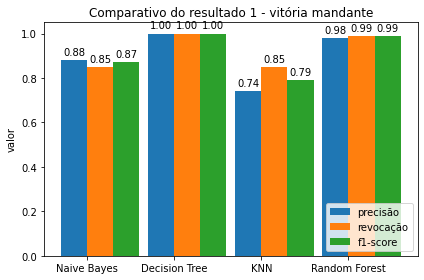

In [125]:
# Gráfico de comparativo de métricas dos modelos resultado 1
precision = [0.88, 1.0, 0.74, 0.98]
recall = [0.85, 1.0, 0.85, 0.99]
f1score = [0.87, 1.0, 0.79, 0.99]
labels = ['precisão', 'revocação', 'f1-score']
models = ['Naive Bayes', 'Decision Tree', 'KNN', 'Random Forest']
width = 0.6/2
x = np.arange(len(precision))

fig, ax = plt.subplots()
r1 = ax.bar(x - width/2, precision, width, label='precisão')
r2 = ax.bar(x + width/2, recall, width, label='revocação')
r3 = ax.bar(x + width + width/2, f1score, width, label='f1-score')

ax.set_ylabel('valor')
ax.set_title('Comparativo do resultado 1 - vitória mandante')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend(loc='lower right')

autolabel(r1)
autolabel(r2)
autolabel(r3)

fig.tight_layout()
plt.show()

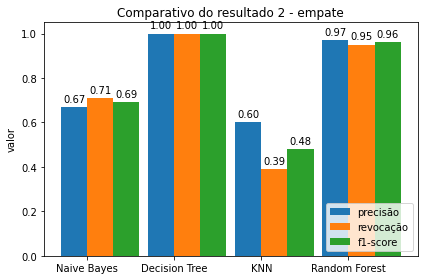

In [126]:
# Gráfico de comparativo de métricas dos modelos resultado 2
precision = [0.67, 1.0, 0.60, 0.97]
recall = [0.71, 1.0, 0.39, 0.95]
f1score = [0.69, 1.0, 0.48, 0.96]
labels = ['precisão', 'revocação', 'f1-score']
models = ['Naive Bayes', 'Decision Tree', 'KNN', 'Random Forest']
width = 0.6/2
x = np.arange(len(precision))

fig, ax = plt.subplots()
r1 = ax.bar(x - width/2, precision, width, label='precisão')
r2 = ax.bar(x + width/2, recall, width, label='revocação')
r3 = ax.bar(x + width + width/2, f1score, width, label='f1-score')

ax.set_ylabel('valor')
ax.set_title('Comparativo do resultado 2 - empate')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend(loc='lower right')

autolabel(r1)
autolabel(r2)
autolabel(r3)

fig.tight_layout()
plt.show()

## Resample na variável target

Nesta seção será utilizada a técnica de resample para balancear a quantidade de valores da variável target **resultado_partida**. Caso algum valor domine a quantidade total de valores, o modelo de machine learning pode ficar enviesado e tender a classificar o resultado da partida com o valor mais frequente da variável target.

A técnica de resample utilizada será a do Random Over-Sampling. Ela aleatoriamente duplica a quantidade de valores minoritários até alcançar a quantidade de valores majoritários e, assim, balancear os valores da variável target **resultado_partida**. A aplicação de resample tem suas desvantagens e, em especial, na técnica de Random Over-Sampling é a de poder causar overfitting.

Irei aplicar o resample nos dados do dataframe ***df_full*** para balancear a variável target **resultado_partida**. Após isto, aplicarei novamente todos os modelos de machine learning com o objetivo de avaliar se a acurácia desses modelos sofrerão alguma modificação no sentido de melhorar a previsão dos modelos.

Não aplicarei a técnica de *cross validation* na base após o resample, porque os valores de acurácia ficou muito próximo do valor sem aplicar tal técnica e o desvio padrão das execuções seguidas do cross validation com valor muito pequeno. Isto aponta para o fato do modelo não estar sofrendo de overfitting.

Com o fim do processo de resample, um novo dataframe será criado com o nome de ***df_resample***.

In [ ]:
# Contando a quantidade de valores da variável target
df_full['resultado_partida'].value_counts()

1    1095
2     624
0     561
Name: resultado_partida, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


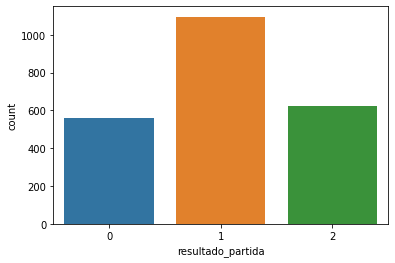

In [ ]:
# Plotando a variável target
sns.countplot(df_full['resultado_partida'])

Podemos observar que o valor 0 é aproximadamente 51% do valor 1 e o valor 2 é cerca de 56% do valor 2.

In [ ]:
# Criando dataframes específicos para cada valor da variável target
df_1 = df_full[df_full['resultado_partida'] == 1]
df_0 = df_full[df_full['resultado_partida'] == 0]
df_2 = df_full[df_full['resultado_partida'] == 2]

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Shape df_resample: (3285, 31)



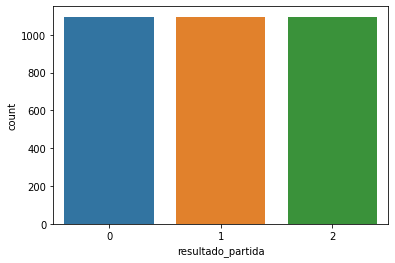

In [ ]:
# Criando dataframes balanceados para os valores 0 e 2 da variável target e 
# igualando com a quantidade do valor 1
# Também será criado um novo dataframe df_resample
df_2s = resample(df_2, replace=True, n_samples=1095, random_state=123)
df_0s = resample(df_0, replace=True, n_samples=1095, random_state=123)

df_resample = pd.concat([df_1, df_2s, df_0s])
print(f'Shape df_resample: {df_resample.shape}')
print()

sns.countplot(df_resample['resultado_partida'])

In [ ]:
# Criando os dados de treinamento e teste
X = df_resample[features]
y = df_resample[target]

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

print(f'X_train => linhas: {X_train.shape[0]} / colunas: {X_train.shape[1]}')
print(f'y_train => linhas: {y_train.count()}')
print()
print(f'X_test  => linhas: {X_test.shape[0]} / colunas: {X_test.shape[1]}')
print(f'y_test  => linhas: {y_test.count()}')

X_train => linhas: 2463 / colunas: 26
y_train => linhas: 2463

X_test  => linhas: 822 / colunas: 26
y_test  => linhas: 822


### Naive Bayes

Aplicação do modelo de machine learning Naive Bayes após o resample.

In [ ]:
gnb = GaussianNB()

gnb = gnb.fit(X_train, y_train)

print(f'Acurácia no treinamento: {gnb.score(X_train, y_train)}')
predict = gnb.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test, predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 0.8181079983759643
Acurácia no teste:       0.8017031630170316

              precision    recall  f1-score   support

           0       0.84      0.82      0.83       276
           1       0.90      0.82      0.86       286
           2       0.67      0.76      0.71       260

    accuracy                           0.80       822
   macro avg       0.81      0.80      0.80       822
weighted avg       0.81      0.80      0.80       822



### Decison Tree

Aplicação do modelo de machine learning Decision Tree após o resample.

In [ ]:
dtc = DecisionTreeClassifier(random_state=0)
dtc = dtc.fit(X_train, y_train)

print(f'Acurácia no treinamento: {dtc.score(X_train, y_train)}')
predict = dtc.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 1.0
Acurácia no teste:       0.9939172749391727

              precision    recall  f1-score   support

           0       1.00      0.99      1.00       276
           1       1.00      0.99      0.99       286
           2       0.98      1.00      0.99       260

    accuracy                           0.99       822
   macro avg       0.99      0.99      0.99       822
weighted avg       0.99      0.99      0.99       822



### KNN

Aplicação do modelo de machine learning KNN após o resample.

In [ ]:
knn = KNeighborsClassifier()
knn = knn.fit(X_train, y_train)

print(f'Acurácia no treinamento: {knn.score(X_train, y_train)}')
predict = knn.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 0.8396264717823793
Acurácia no teste:       0.7396593673965937

              precision    recall  f1-score   support

           0       0.74      0.80      0.77       276
           1       0.83      0.74      0.78       286
           2       0.65      0.67      0.66       260

    accuracy                           0.74       822
   macro avg       0.74      0.74      0.74       822
weighted avg       0.74      0.74      0.74       822



### Random Forest

Aplicação do modelo de machine learning Random Forest após o resample.

In [ ]:
rfc = RandomForestClassifier()
rfc = rfc.fit(X_train, y_train)

print(f'Acurácia no treinamento: {rfc.score(X_train, y_train)}')
predict = rfc.predict(X_test)
print(f'Acurácia no teste:       {accuracy_score(y_test,predict)}')
print()
print(classification_report(y_test, predict))

Acurácia no treinamento: 1.0
Acurácia no teste:       0.9890510948905109

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       276
           1       1.00      0.99      1.00       286
           2       0.98      0.99      0.98       260

    accuracy                           0.99       822
   macro avg       0.99      0.99      0.99       822
weighted avg       0.99      0.99      0.99       822



## Motivo usar normalização
O próximo passo foi a normalização dos valores visando um melhor desempenho dos algoritmos de classificação que serão usados (Figura 74). O objetivo da normalização é alterar os valores das colunas numéricas no conjunto de dados para uma escala comum, sem distorcer as diferenças nos intervalos de valores.

Para machine learning, nem todos os conjuntos de dados requerem normalização, devendo o método ser necessário apenas quando os parâmetros tiverem intervalos muito diferentes[5].

[5]https://medium.com/tentando-ser-um-unic%C3%B3rnio/porqu%C3%AA-e-quando-%C3%A9-necess%C3%A1rio-normalizar-os-dados-92e5cce445aa


## Trabalhos comuns
*   TCC Ciência de Dados - HMO: tem 6 modelos de classificação, explica cada um, mostra a comparação em uma tabela com os valores de acurácia, precisão, revocação e f1-score (explica cada um deles).
*   TCC Ciência de Dados 2019 - Yuri Aranha Kawagoe: interpreta os resultados a partir dos valores de acurácia, precisão e etc.
*   https://www.kaggle.com/sslp23/modelo-de-previs-o-para-o-campeonato-brasileiro/notebook: aplicação do naive bayes